# Fine plotting of case study 

In [2]:
library("dplyr")
library("readr")
library("ggplot2")
library("purrr")
library("stringr")
library("tidyr")
library("susiF.alpha")


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




## Complex example: TAD 1182

In [37]:
color = c("black", "dodgerblue2", "green4", "#6A3D9A",
      "#FF7F00", "gold1", "skyblue2", "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
plot_range = c(32600000,34360000)

 ## Define Function
    update_cal_credible_band2 <- function(susiF.obj )
    {
    
    
    
      if(sum( is.na(unlist(susiF.obj$alpha))))
      {
        stop("Error: some alpha value not updated, please update alpha value first")
      }
      temp <- wavethresh::wd(rep(0, susiF.obj$n_wac))
    
    
      for ( l in 1:susiF.obj$L)
      {
        Smat <-  susiF.obj$fitted_wc2[[l]]
        W1   <- ((wavethresh::GenW(n=  ncol(Smat )  , filter.number = 10, family = "DaubLeAsymm")))
        tt   <- diag( W1%*%diag(c(susiF.obj$alpha[[l]]%*%Smat ))%*% t(W1 ))
    
        up                       <-  susiF.obj$fitted_func[[l]]+ 3*sqrt(tt)
        low                      <-  susiF.obj$fitted_func[[l]]- 3*sqrt(tt)
        susiF.obj$cred_band[[l]] <- rbind(up, low)
      }
    for (i in 1:susiF.obj$L){
    rownames(susiF.obj$cred_band[[i]]) = paste0("Effect_",i,":",rownames(susiF.obj$cred_band[[i]]))

    }
    
    
      return(susiF.obj)
    }


effect_extract_df = function(fsusie,n = 1:length(fsusie$fitted_func) ){
    color = c("black", "dodgerblue2", "green4", "#6A3D9A",
      "#FF7F00", "gold1", "skyblue2", "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
     plot_df = ((fsusie$fitted_func[n])%>%as_tibble(.name_repair = "universal")%>%mutate(pos =  fsusie$outing_grid)%>%`colnames<-`(c(paste0("Effect_",n,":mid"),"pos"))%>%mutate(`#chr` = str_split(names(fsusie$csd_X)[[1]],":")[[1]][[1]] ))%>%dplyr::select(`#chr`, pos, everything())
    plot_df = cbind(plot_df ,t(Reduce(rbind,fsusie$cred_band[n]))  )
    plot_df = plot_df%>%pivot_longer(cols = 3:ncol(plot_df), names_to = c("effect",".value"),names_prefix = "" , names_sep = ":") 
     return(plot_df)
     }


In [33]:
## Define Function
    update_cal_credible_band2 <- function(susiF.obj )
    {
    
    
    
      if(sum( is.na(unlist(susiF.obj$alpha))))
      {
        stop("Error: some alpha value not updated, please update alpha value first")
      }
      temp <- wavethresh::wd(rep(0, susiF.obj$n_wac))
    
    
      for ( l in 1:susiF.obj$L)
      {
        Smat <-  susiF.obj$fitted_wc2[[l]]
        W1   <- ((wavethresh::GenW(n=  ncol(Smat )  , filter.number = 10, family = "DaubLeAsymm")))
        tt   <- diag( W1%*%diag(c(susiF.obj$alpha[[l]]%*%Smat ))%*% t(W1 ))
    
        up                       <-  susiF.obj$fitted_func[[l]]+ 3*sqrt(tt)
        low                      <-  susiF.obj$fitted_func[[l]]- 3*sqrt(tt)
        susiF.obj$cred_band[[l]] <- rbind(up, low)
      }
    for (i in 1:susiF.obj$L){
    rownames(susiF.obj$cred_band[[i]]) = paste0("Effect_",i,":",rownames(susiF.obj$cred_band[[i]]))

    }
    
    
      return(susiF.obj)
    }

In [4]:
color = c("black", "dodgerblue2", "green4", "#6A3D9A",
      "#FF7F00", "gold1", "skyblue2", "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
extract_table = function(variant_df,type){
if("purity" %in% colnames(variant_df) ){
  variant_df$purity[is.na(variant_df$purity)] = 0
  variant_df[abs(variant_df$purity) < 0.5,7] = 0
  }
 variant_df = variant_df%>%mutate(CS = (cs_order%>%as.factor%>%as.numeric-1)%>%as.factor)%>%
      dplyr::select( y = pip ,snp = variants,pos = position , CS, molecular_trait_id)%>%mutate(molecular_trait_id = paste0(type,"_",molecular_trait_id ) )
return(variant_df)
}
plot_recipe = tibble( type =  c('meQTL','haQTL','eQTL','eQTL'), path = c('/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/f_susie_tad_meQTL_pos_limited_2//result/meQTL.yuqi_mqtl.tad1182.uni_Fsusie.mixture_normal_per_scale.variant.tsv','/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/f_susie_tad_haQTL_pos_check_pure_2/result/haQTL.rosmap_haqtl.tad1182.uni_Fsusie.mixture_normal_per_scale.variant.tsv','/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad/demo.ENSG00000184984.unisusie.fit.variant.tsv','/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad/demo.ENSG00000259505.unisusie.fit.variant.tsv'))
plot_list = map2(plot_recipe$type,plot_recipe$path, ~read_delim(.y, guess_max = 10000000)%>%extract_table(.x) )
plot_df = Reduce(rbind,plot_list)
plot_range = (plot_df%>%group_by(molecular_trait_id)%>%summarize(start = (min(pos)), end = (max(pos)))%>%mutate(start = median(start),end = median(end)))[1,c(2,3)]%>%as.matrix
plot_chr = (plot_df$snp[1]%>%stringr::str_split(":"))[[1]][1]
plot_df = plot_df%>%mutate(Shared = as.logical(map(snp, ~(plot_df%>%filter( snp ==.x ,   CS%>%as.numeric !=  1 )%>%nrow()) > 1  )))
pip_plot <- plot_df%>%ggplot2::ggplot(aes(y = y, x = pos,
                              col =  CS, shape = Shared )) + facet_grid(molecular_trait_id ~.)+
  geom_point(size = 7) +
  scale_color_manual("CS",values = color) +
  theme(axis.ticks.x = element_blank()) +
 ylab("Posterior Inclusion Probability (PIP)")+xlim(plot_range)+
  theme(axis.ticks.x = element_blank()) +
        theme(strip.text.y.right = element_text(angle = 0))+
        xlab("") +
        theme(text = element_text(size = 30))+ggtitle("Overview of fine-mapping")

Rows: 5928 Columns: 14
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (4): variants, ref, alt, molecular_trait_id
dbl (10): snps_index, chromosome, position, cs_order, pip, finemapped_region...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 5928 Columns: 14
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (4): variants, ref, alt, molecular_trait_id
dbl (10): snps_index, chromosome, position, cs_order, pip, finemapped_region...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 5928 Columns: 16
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): variants, ref, alt, cs_order, cs_id, log10_base_factor, molecul

In [16]:
options(repr.plot.width =9, repr.plot.height = 16)

In [9]:
pipplot = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/1182/meQTL_haQTL_eQTL_eQTL_eQTL.tad1182.pip_landscape_plot.rds")

In [10]:
options(repr.plot.width =30, repr.plot.height = 40)

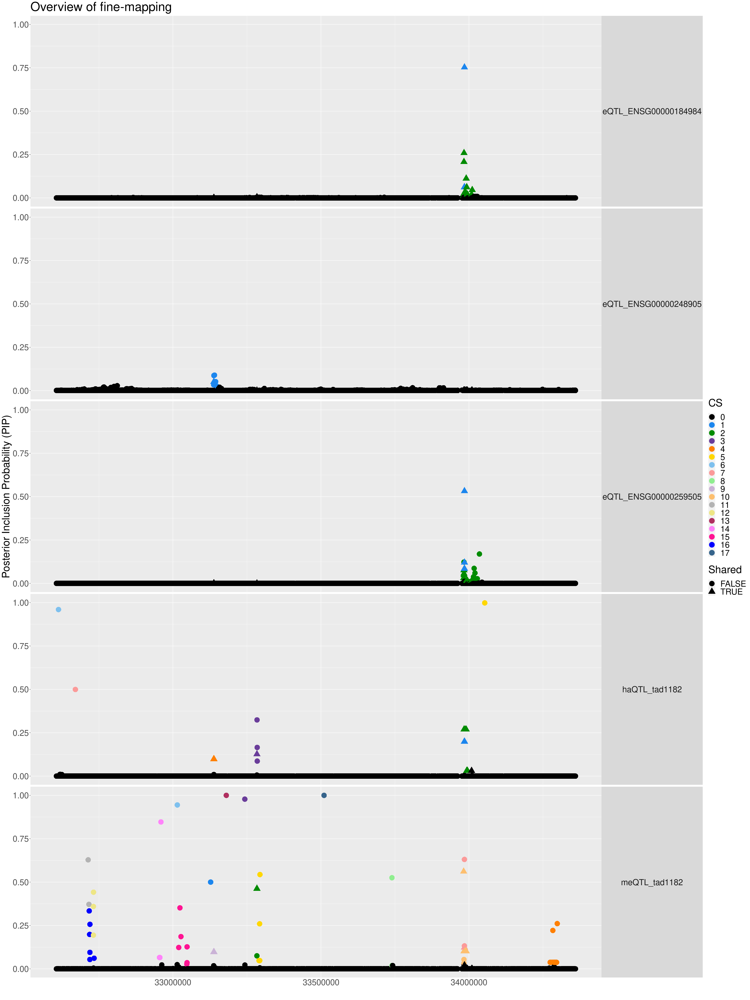

In [11]:
pipplot[[1]]

In [12]:
plot_df = pipplot[[2]]

In [13]:
plot_df

y,snp,pos,CS,molecular_trait_id,Shared
<dbl>,<chr>,<dbl>,<fct>,<chr>,<lgl>
1.209033e-13,chr15:32606430_C_G,32606430,0,meQTL_tad1182,FALSE
3.474998e-13,chr15:32606447_A_G,32606447,0,meQTL_tad1182,FALSE
1.604272e-13,chr15:32606610_G_C,32606610,0,meQTL_tad1182,FALSE
1.345590e-13,chr15:32606749_GAA_GAAA,32606749,0,meQTL_tad1182,FALSE
1.204592e-13,chr15:32607667_C_T,32607667,0,meQTL_tad1182,FALSE
1.894040e-13,chr15:32607691_C_A,32607691,0,meQTL_tad1182,FALSE
1.194245e-11,chr15:32607719_C_T,32607719,0,meQTL_tad1182,FALSE
3.064216e-13,chr15:32607745_C_T,32607745,0,meQTL_tad1182,FALSE
1.204592e-13,chr15:32607813_AC_A,32607813,0,meQTL_tad1182,FALSE


In [14]:
plot_df%>%count(molecular_trait_id)

molecular_trait_id,n
<chr>,<int>
eQTL_ENSG00000184984,5928
eQTL_ENSG00000248905,5928
eQTL_ENSG00000259505,5928
haQTL_tad1182,5928
meQTL_tad1182,5928


In [15]:
plot_df%>%mutate(new_CS = case_when(molecular_trait_id == "meQTL_tad1182" & CS == 2 ~  3,
                                    molecular_trait_id == "meQTL_tad1182" & CS == 3 ~  10,
                                    molecular_trait_id == "meQTL_tad1182" & CS == 9 ~ 4,
                                    molecular_trait_id == "meQTL_tad1182" & CS == 4 ~ 9,
                                    molecular_trait_id == "meQTL_tad1182" & CS == 10 ~ 2,
                                    molecular_trait_id == "meQTL_tad1182" & CS == 7 ~ 1,
                                    molecular_trait_id == "meQTL_tad1182" & CS == 1 ~ 7,
                                    molecular_trait_id == "eQTL_ENSG00000248905" & CS == 1 ~ 4,
                                    .default = as.numeric(CS)-1 
                                   ), molecular_trait_id = str_replace(molecular_trait_id,"ENSG00000248905","FMN1")%>%str_replace("ENSG00000184984","CHRM5")%>%str_replace("ENSG00000259505","AC009268.1")   ) -> plot_df_2

### Check that the swapping is right

In [16]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 1,molecular_trait_id == "meQTL_tad1182" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>
0,5
1,10


In [17]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 2,molecular_trait_id == "meQTL_tad1182" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>
0,7
2,13


In [18]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 3,molecular_trait_id == "meQTL_tad1182" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>
0,6
3,4


In [19]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 4,molecular_trait_id == "meQTL_tad1182" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>
0,20
4,30


In [20]:
plot_df_2 = plot_df_2%>%mutate(molecular_trait_id = ifelse(molecular_trait_id == "meQTL_tad1182", "mQTL_tad1182",molecular_trait_id ))

In [21]:
plot_df_2%>%count(molecular_trait_id)

molecular_trait_id,n
<chr>,<int>
eQTL_AC009268.1,5928
eQTL_CHRM5,5928
eQTL_FMN1,5928
haQTL_tad1182,5928
mQTL_tad1182,5928


In [71]:
plot_df_2%>%filter(molecular_trait_id != "eQTL_AC009268.1")%>%write_delim("4_1182_pip.tsv")

In [22]:
refine_plot = plot_df_2%>%filter(molecular_trait_id != "eQTL_AC009268.1")%>%ggplot2::ggplot(aes(y = y, x = pos,
                              col =  as.factor(new_CS), shape = Shared )) + facet_grid(molecular_trait_id ~.)+
  geom_point(size = 7) +
  scale_color_manual("CS",values = color) +theme_bw()+
  theme(axis.ticks.x = element_blank()) +
 ylab("Posterior Inclusion Probability (PIP)")+xlim(plot_range)+
  theme(axis.ticks.x = element_blank()) +
        theme(strip.text.y.right = element_text(angle = 0))+
        xlab("") +
        theme(text = element_text(size = 30))

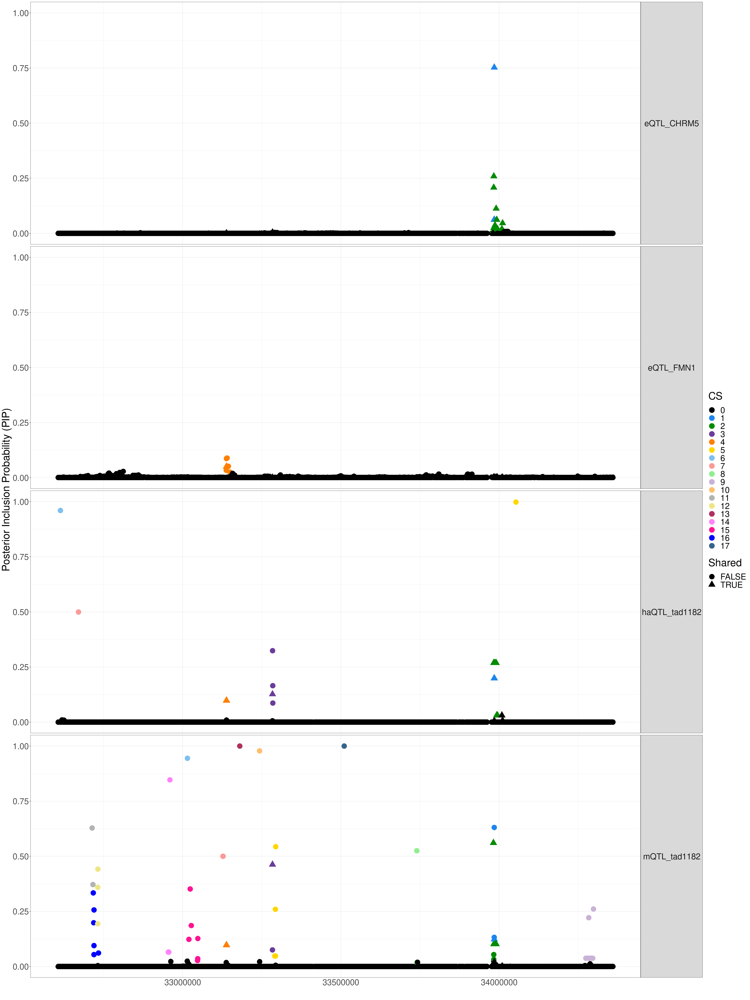

In [70]:
refine_plot

### For each CS of interest

In [24]:
susiF_obj_me =   readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_mQTL/meQTL.yuqi_mqtl.tad1182.uni_Fsusie.mixture_normal_per_scale.rds")
susiF_obj_me = update_cal_credible_band2(susiF_obj_me)

In [60]:

susiF_obj_ha =  readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_haQTL/haQTL.rosmap_haqtl.tad1182.uni_Fsusie.mixture_normal_per_scale.rds")
susiF_obj_ha = update_cal_credible_band2(susiF_obj_ha)

In [61]:
susiF_obj_ha$cs

[[1]]
chr15:33984369_G_A chr15:33984479_T_C chr15:33984537_A_G chr15:33984788_G_T 
              4816               4819               4820               4823 
chr15:33985176_A_G 
              4825 

[[2]]
chr15:33983367_C_T chr15:33987067_T_C chr15:33990730_C_T chr15:33992399_G_A 
              4809               4831               4845               4852 
chr15:33992465_C_G chr15:33992640_C_T chr15:33993620_T_A chr15:33995114_T_G 
              4853               4854               4855               4857 

[[3]]
chr15:33284055_C_A chr15:33284644_G_A chr15:33284682_C_T chr15:33283723_G_T 
              2525               2534               2535               2522 
chr15:33283835_G_T chr15:33284812_C_T 
              2524               2537 

[[4]]
chr15:33137821_A_G chr15:33137845_C_T chr15:33137871_G_A chr15:33138029_A_G 
              1920               1921               1922               1923 
chr15:33138447_C_T chr15:33138563_T_C chr15:33138603_G_A chr15:33138641_A_G 
              1926               1927               1928               1929 
chr15:33138662_C_T chr15:33138823_G_T 
              1930               1931 

[[5]]
chr15:34053316_AAAAATATATAT_ATAAAATATATAT 
                                     5016 

[[6]]
chr15:32613417_A_C 
                28 

[[7]]
chr15:32670441_T_C chr15:32670558_A_G 
               150                151

In [26]:
susiF_obj_me$cs

[[1]]
chr15:33127170_AGAG_A  chr15:33127639_ACT_A 
                 1872                  1877 

[[2]]
chr15:33283723_G_T chr15:33283835_G_T chr15:33283667_A_C 
              2522               2524               2521 

[[3]]
chr15:33242856_C_T 
              2255 

[[4]]
    chr15:34298343_T_C chr15:34283380_T_TAATC     chr15:34274396_A_G 
                  5699                   5653                   5640 
    chr15:34279723_C_T     chr15:34279877_G_A     chr15:34280813_G_A 
                  5648                   5649                   5650 
    chr15:34285592_T_G     chr15:34286062_G_A     chr15:34286187_A_C 
                  5660                   5666                   5668 
    chr15:34287868_G_T     chr15:34287943_G_A     chr15:34291491_C_T 
                  5673                   5674                   5684 
    chr15:34292244_A_C     chr15:34293609_C_T     chr15:34296044_T_A 
                  5688                   5691                   5695 

[[5]]
chr15:33293988_C_T chr15:33292878_A_C chr15:33290892_T_C chr15:33292989_G_A 
              2578               2571               2561               2572 
chr15:33293029_C_A chr15:33293287_G_A 
              2573               2575 

[[6]]
chr15:33014885_C_T chr15:33014336_G_A 
              1300               1297 

[[7]]
chr15:33984698_A_G chr15:33984694_A_G chr15:33984852_C_T chr15:33984369_G_A 
              4822               4821               4824               4816 
chr15:33984479_T_C 
              4819 

[[8]]
               chr15:33739930_G_A                chr15:33740024_G_C 
                             4061                              4062 
               chr15:33740188_T_C                chr15:33740253_A_G 
                             4063                              4065 
               chr15:33740334_A_G                chr15:33740520_G_C 
                             4066                              4068 
               chr15:33740596_C_T                chr15:33740639_C_T 
                             4069                              4070 
               chr15:33740830_C_A                chr15:33741013_G_T 
                             4072                              4073 
               chr15:33741071_G_A                chr15:33741286_G_A 
                             4074                              4075 
               chr15:33741574_T_C                chr15:33741587_G_T 
                             4076                              4077 
chr15:33741598_AGTTTTGTTTT_AGTTTT                chr15:33741645_A_G 
                             4078                              4079 
               chr15:33741677_C_G                chr15:33741715_G_A 
                             4080                              4081 
               chr15:33741775_G_A                chr15:33741818_G_A 
                             4082                              4083 
               chr15:33741839_T_C                chr15:33741910_G_A 
                             4084                              4086 
               chr15:33741923_G_T                chr15:33742101_T_C 
                             4087                              4088 

[[9]]
chr15:33137821_A_G chr15:33137845_C_T chr15:33137871_G_A chr15:33138029_A_G 
              1920               1921               1922               1923 
chr15:33138447_C_T chr15:33138563_T_C chr15:33138603_G_A chr15:33138641_A_G 
              1926               1927               1928               1929 
chr15:33138662_C_T chr15:33138823_G_T 
              1930               1931 

[[10]]
              chr15:33982146_C_T               chr15:33983367_C_T 
                            4783                             4809 
              chr15:33987067_T_C               chr15:33990730_C_T 
                            4831                             4845 
            chr15:33983231_CAT_C chr15:33983200_GTATATATATA_GTATA 
                            4806                             4800 

[[11]]
 chr15:32713674_C_T chr15:32

In [27]:
effect_extract = function(fsusie,n = 1:length(fsusie$fitted_func) ){
     plot_df = ((fsusie$fitted_func[n])%>%as_tibble(.name_repair = "universal")%>%mutate(pos =  fsusie$outing_grid)%>%`colnames<-`(c(paste0("Effect_",n),"pos"))%>%mutate(`#chr` = str_split(names(fsusie$csd_X)[[1]],":")[[1]][[1]] ))%>%dplyr::select(`#chr`, pos, everything())
     plot=  plot_df%>%pivot_longer(cols = 3:ncol(plot_df),names_to = "effect", values_to = "values"   ) %>%ggplot(aes(x = pos, y = values,color = effect),linewidth = 7)+
     geom_line()+ylab("Estimated Effect") + xlab("POS")+facet_grid(effect~. )+
         scale_color_manual("Credible set",values = color[n+1])+geom_line(aes(y = 0), color = "black")+
         theme(strip.text.y.right = element_text(angle = 0))+
         xlab("") + 
         ylab("Estimated Effect")+ 
         theme(text = element_text(size = 50))+
         ggtitle(paste0( "Estimated effect for ${f'{_input:br}'.split('.')[-4]}"))
     return(list(plot_df,plot))
     }




ERROR: Error in parse(text = x, srcfile = src): <text>:14:18: unexpected symbol
13:                  
14:                  f
                     ^


In [28]:
 output_me = effect_extract_df(susiF_obj_me,n = c(2,7,9,10,6))

New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`


### Get the right original CS

In [29]:
 output_me = effect_extract_df(susiF_obj_me,n = c(2,7,9,10,6))
 output_ha = effect_extract_df(susiF_obj_ha,n = c(1,2,3,4))


New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`


### Gene plot

In [3]:
gene_name = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.region_list")
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 60726 Columns: 5
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): #chr, gene_id, gene_name
dbl (2): start, end

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [4]:
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


hr15	33194713	33194714	ENSG00000248905	FMN1
chr15	33968496	33968497	ENSG00000184984	CHRM5
chr15	33990685	33990686	ENSG00000259505	AC009268.1


In [5]:
gene_exom = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 3073921 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [6]:
gene_exom = gene_exom %>%filter(X1 == "chr15", X4 >= 32600000, X5 <=  34360000)

In [49]:
gene_exom%>%filter(str_detect(X9, "AVEN"))

X1,X2,X3,X4,X5,X6,X7,X8,X9
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
chr15,ensembl_havana,gene,33858782,34075155,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding"";"
chr15,havana,transcript,33858782,34075155,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript"";"
chr15,havana,exon,34074436,34075155,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""1""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003899222""; exon_version ""1"";"
chr15,havana,exon,34070588,34070651,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""2""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003899683""; exon_version ""1"";"
chr15,havana,exon,34066659,34066811,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""3""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003902482""; exon_version ""1"";"
chr15,havana,exon,34065972,34066160,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""4""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003904049""; exon_version ""1"";"
chr15,havana,exon,34062922,34063432,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""5""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003902022""; exon_version ""1"";"
chr15,havana,exon,34003032,34003209,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""6""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003901142""; exon_version ""1"";"
chr15,havana,exon,33875925,33875995,.,-,.,"gene_id ""ENSG00000169857""; gene_version ""9""; transcript_id ""ENST00000675287""; transcript_version ""1""; exon_number ""7""; gene_name ""AVEN""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding""; transcript_name ""AVEN-204""; transcript_source ""havana""; transcript_type ""processed_transcript""; exon_id ""ENSE00003575935""; exon_version ""1"";"


In [13]:
exom = gene_exom%>%filter(str_detect(X9, c("ENSG00000184984"))| str_detect(X9,"ENSG00000248905") | str_detect(X9, "ENSG00000198838") )%>%filter(X3 == "exon")

In [31]:
exom%>%write_delim("4_1182_gene_exom_ryr3.tsv","\t")

In [15]:
gene_body%>%filter(X4%in% c(33194714,33968497,33990686,33194713,33310961,33310962)| X5 == 33194714 , X3 == "gene")

X1,X2,X3,X4,X5,X6,X7,X8,X9
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
chr15,ensembl_havana,gene,32765544,33194714,.,-,.,"gene_id ""ENSG00000248905""; transcript_id ""ENSG00000248905""; gene_type ""protein_coding""; gene_name ""FMN1""; transcript_type ""protein_coding""; transcript_name ""FMN1""; gene_version ""10""; gene_source ""ensembl_havana"";"
chr15,ensembl_havana,gene,33310962,33866121,.,+,.,"gene_id ""ENSG00000198838""; transcript_id ""ENSG00000198838""; gene_type ""protein_coding""; gene_name ""RYR3""; transcript_type ""protein_coding""; transcript_name ""RYR3""; gene_version ""14""; gene_source ""ensembl_havana"";"
chr15,ensembl_havana,gene,33968497,34067458,.,+,.,"gene_id ""ENSG00000184984""; transcript_id ""ENSG00000184984""; gene_type ""protein_coding""; gene_name ""CHRM5""; transcript_type ""protein_coding""; transcript_name ""CHRM5""; gene_version ""10""; gene_source ""ensembl_havana"";"
chr15,havana,gene,33990686,33992048,.,+,.,"gene_id ""ENSG00000259505""; transcript_id ""ENSG00000259505""; gene_type ""processed_pseudogene""; gene_name ""AC009268.1""; transcript_type ""processed_pseudogene""; transcript_name ""AC009268.1""; gene_version ""1""; gene_source ""havana"";"


In [16]:
gene_info = gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000259505","ENSG00000198838"))

In [17]:
gene_info

#chr,start,end,gene_id,gene_name
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr15,33194713,33194714,ENSG00000248905,FMN1
chr15,33310961,33310962,ENSG00000198838,RYR3
chr15,33968496,33968497,ENSG00000184984,CHRM5
chr15,33990685,33990686,ENSG00000259505,AC009268.1


In [18]:
gene_info = gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000259505","ENSG00000198838"))%>%mutate(end = c(32765544,33866121,34067458,33992048 ), strand = c(2,1,1,1) )%>%mutate(plot_group = c(2,1,2,2))

In [19]:
gene_info%>%mutate(dist = start-end)

#chr,start,end,gene_id,gene_name,strand,plot_group,dist
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
chr15,33194713,32765544,ENSG00000248905,FMN1,2,2,429169
chr15,33310961,33866121,ENSG00000198838,RYR3,1,1,-555160
chr15,33968496,34067458,ENSG00000184984,CHRM5,1,2,-98962
chr15,33990685,33992048,ENSG00000259505,AC009268.1,1,2,-1363


In [20]:
gene_plot = gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000259505"))%>%mutate(plot_group = c(2,1,2))%>%
                            ggplot(aes())+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) + 
                            geom_label(aes(x = (start),y = "", label = gene_name,group =  plot_group ), position = position_dodge(width = 1),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_text(size = 10), axis.text.x = element_blank())+xlim(plot_range)

ERROR: Error in limits(c(...), "x"): object 'plot_range' not found


In [21]:
gene_info%>%
                            ggplot(aes()) + geom_segment( aes(x = start,xend = end, y = "", yend = "" ) , arrow = arrow(length = unit(0.5, "cm")) )+theme_bw()+
                            geom_label(aes(x = (start),y = "", label = gene_name,group =  plot_group ), position = position_dodge(width = 1),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_text(size = 10))+xlim(plot_range)+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) -> gene_plot

ERROR: Error in limits(c(...), "x"): object 'plot_range' not found


In [39]:
gene_info%>%write_delim("4_1182_gene_ryr3.tsv","\t")

In [40]:
gene_info

#chr,start,end,gene_id,gene_name,strand,plot_group
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>
chr15,33194713,32765544,ENSG00000248905,FMN1,2,2
chr15,33310961,33866121,ENSG00000198838,RYR3,1,1
chr15,33968496,34067458,ENSG00000184984,CHRM5,1,2
chr15,33990685,33992048,ENSG00000259505,AC009268.1,1,2


In [29]:
plot_range = c(32600000,34360000)


In [75]:
gene_info

#chr,start,end,gene_id,gene_name,strand,plot_group
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>
chr15,33194713,32765544,ENSG00000248905,FMN1,2,2
chr15,33310961,33866121,ENSG00000198838,RYR3,1,1
chr15,33968496,34067458,ENSG00000184984,CHRM5,1,2
chr15,33990685,33992048,ENSG00000259505,AC009268.1,1,2


In [22]:
plot_range = c(32600000,34360000)
gene_info%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000198838"))%>%
                            ggplot(aes()) + geom_segment( aes(x = start,xend = end, y = "", yend = "" ) , arrow = arrow(length = unit(0.5, "cm")) )+
                            geom_label(aes(x = (start),y = "1", label = gene_name), position = position_dodge(width = 10),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_blank())+xlim(plot_range)+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) -> gene_plot 

Rows: 843 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


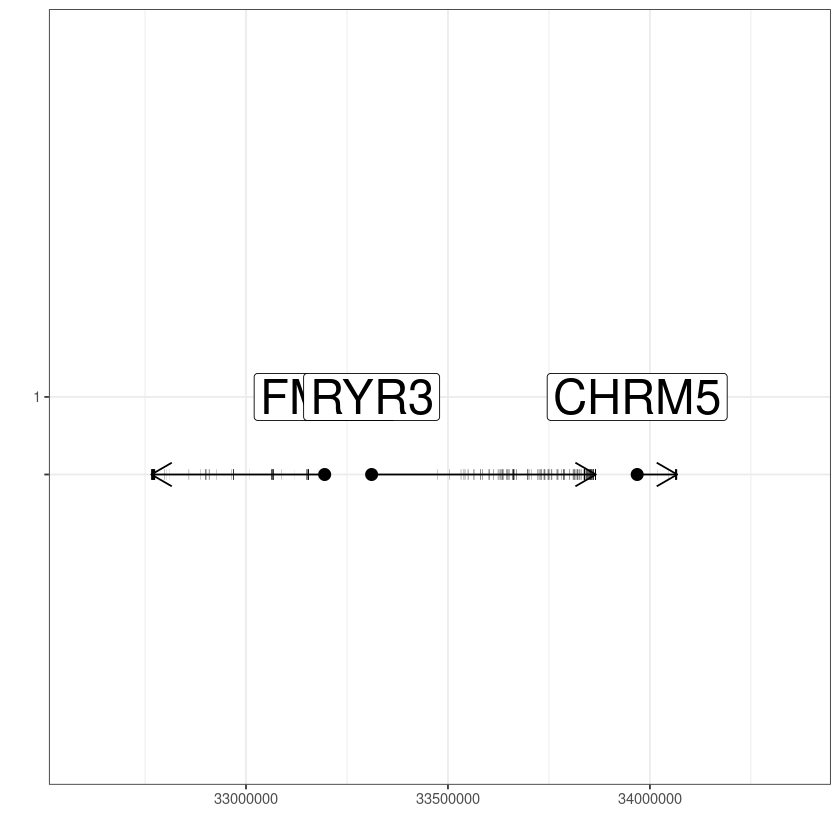

In [32]:
gene_plot+theme_bw()+geom_segment( aes(x = X4,xend = X5, y = "", yend = "" ),size  = 3, data = read_delim("4_1182_gene_exom_ryr3.tsv","\t"))

In [69]:
gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905"))%>%mutate(end = c(32765544,34067458 ), strand = c(2,1) )%>%mutate(plot_group = c(1,2))%>%write_delim("4_1182_gene.tsv","\t")

In [39]:
gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000259505"))

#chr,start,end,gene_id,gene_name
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr15,33194713,33194714,ENSG00000248905,FMN1
chr15,33968496,33968497,ENSG00000184984,CHRM5
chr15,33990685,33990686,ENSG00000259505,AC009268.1


### Swapping the name

In [40]:
mapper = c("Effect_3"  =   "Effect_2" ,
"Effect_4"  =   "Effect_9" ,
"Effect_2"  =   "Effect_10" ,
"Effect_1"  =   "Effect_7",
           "Effect_6" = "Effect_6")

In [41]:
output_me = output_me%>%mutate(effect = map_chr(effect,~names(mapper[which(mapper == .x)])))

In [42]:
output_me = output_me%>%mutate(type = paste0("mQTL_" , effect ))
output_ha = output_ha%>%mutate(type = paste0( "haQTL_",effect ))
                              

In [43]:
min(output_me$pos)

[1] 32708993

In [44]:
min(output_ha$pos)

[1] 32706150

In [45]:
n = c(1,2,3,4)

### Plotting refine CS plot

In [46]:
rbind(output_me,output_ha)%>%count(effect)

effect,n
<chr>,<int>
Effect_1,320
Effect_2,320
Effect_3,320
Effect_4,320
Effect_6,256


In [65]:
color2 = c("black", "dodgerblue2", "green4", "#6A3D9A","#FF7F00","skyblue2","#6A3D9A",
       "gold1",  "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
refine_effect_plot =  rbind(output_me,output_ha)%>%group_by(effect)%>%filter(!effect %in% c("Effect_6"))%>%ggplot(linewidth = 7)+
     geom_line(aes(x = pos, y = mid,color = effect))+geom_ribbon(aes(x = pos, y = mid,ymin = low, ymax = up,fill = effect), alpha = 0.2)+
         ylab("Estimated Effect") + xlab("POS")+facet_grid(factor(type,levels =  c("haQTL_Effect_1","mQTL_Effect_1","haQTL_Effect_2","mQTL_Effect_2","haQTL_Effect_3","mQTL_Effect_3","haQTL_Effect_4","mQTL_Effect_4"), labels =   c("haQTL_CS_1","mQTL_CS_1","haQTL_CS_2","mQTL_CS_2","haQTL_CS_3","mQTL_CS_3","haQTL_CS_4","mQTL_CS_4"))~. )+
         scale_color_manual("Credible set",values = color2[n+1])+geom_hline(aes(yintercept = 0), color = "black")+
         scale_fill_manual("Credible set",values = color2[n+1])+theme_bw()+
         xlab("") + 
         ylab("Estimated Effect")+ 
         theme(text = element_text(size = 40))+  theme(plot.margin=unit(c(5,0,0,0),"mm"), strip.text.y.right = element_text(angle = 0,size = 20),axis.text.x = element_blank(),axis.text.y = element_text(size = 25))

In [67]:
rbind(output_me,output_ha)%>%group_by(effect)%>%filter(!effect %in% c("Effect_6"))%>%write_delim("4_1182_effect.tsv","\t")

In [62]:
#color2 = c("black","dodgerblue2", "green4", "#6A3D9A", "#FF7F00",
#       "gold1", "skyblue2", "#FB9A99", "palegreen2",
#      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
#      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
#      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
#      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
#      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
#refine_effect_plot = rbind(output_me,output_ha)%>%group_by(effect)%>%filter()%>%ggplot(linewidth = 7)+
#     geom_line(aes(x = pos, y = mid,color = effect))+geom_ribbon(aes(x = pos, y = mid,ymin = low, ymax = up,fill = effect), alpha = 0.2)+
#         ylab("Estimated Effect") + xlab("POS")+facet_grid(type~. )+
#         scale_color_manual("Credible set",values = color2[n+1])+geom_hline(aes(yintercept = 0), color = "black")+
#         scale_fill_manual("Credible set",values = color2[n+1])+theme_bw()+
#         xlab("") + 
#         ylab("Estimated Effect")+ 
#         theme(text = element_text(size = 40))+  theme(strip.text.y.right = element_text(angle = 0,size = 20),axis.text.x = element_blank() )

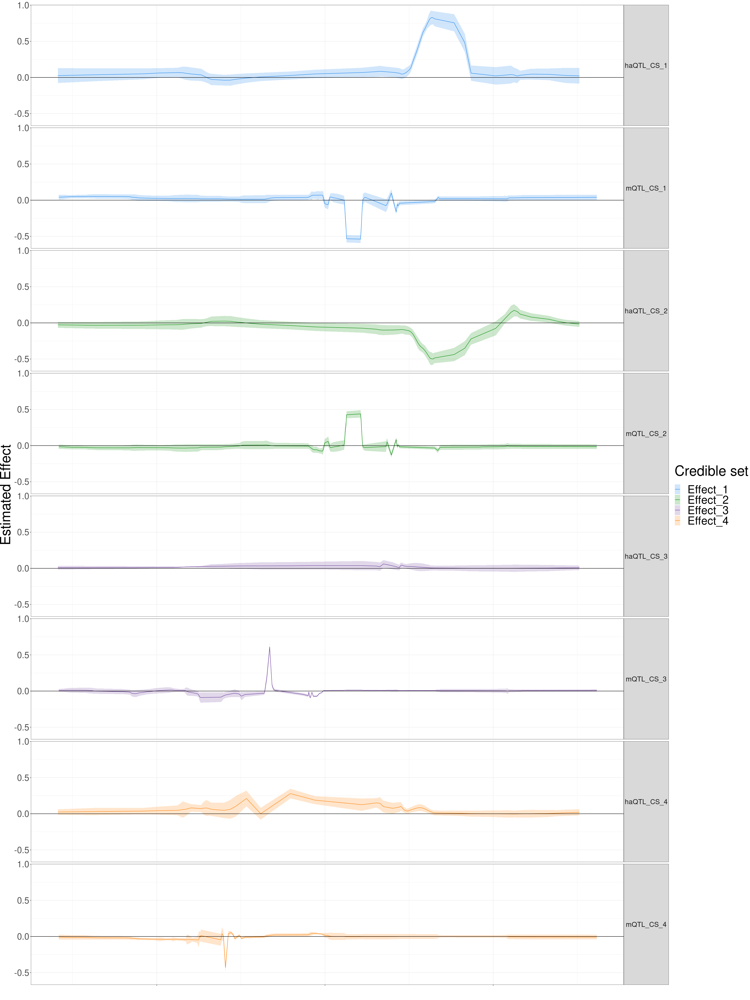

In [66]:
refine_effect_plot

In [18]:
options(repr.plot.width =30, repr.plot.height = 40)

In [38]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(6,1,6))


ERROR: Error in cowplot::plot_grid(plotlist = list(refine_effect_plot + xlim(plot_range), : object 'refine_effect_plot' not found


In [53]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(6,1,6))%>%ggsave(filename = "CaseStudy_tad1182.pdf",device = "pdf", width = 30, height = 30,dpi = "retina")

### Check LD of CS

In [ ]:
genotype = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/rerun/cache//fsusie.rosmap_haqtl.tad1182.uni_Fsusie.mixture_normal_per_scale.rds")


In [ ]:
names(unlist(susiF_obj_me$cs[1:2]))

In [ ]:
names(unlist(susiF_obj_me$cs) )[c(7,10)] == names(unlist(susiF_obj_me$cs )) [c(7,10)]

In [ ]:
cor(genotype$input_data$X[,names(unlist(susiF_obj_ha$cs[1:2]))])

In [ ]:
susiF_obj_ha$input_data = genotype$input_data

In [ ]:
genotype_me= readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/rerun/cache//fsusie.yuqi_mqtl.tad1182.uni_Fsusie.mixture_normal_per_scale.rds")


In [ ]:
genotype_me$input_data[[1]]

In [ ]:
susiF_obj_me$input_data = genotype_me$input_data

In [ ]:
list(haQTL = susiF_obj_ha, mQTL = susiF_obj_me )%>%saveRDS("tad1182_fsusie_m_ha_cs_selected_result__input_data.rds")

In [ ]:
susiF_obj_me$cs[c(7,10,2,9)]%>%unlist%>%names() == susiF_obj_ha$cs[c(1,2,3,4)]%>%unlist%>%names()

In [ ]:
susiF_obj_me$cs[c(10,7,2,9)]%>%unlist%>%names() == susiF_obj_ha$cs[c(1,2,3,4)]%>%unlist%>%names()

In [10]:
intersect(susiF_obj_me$cs[c(9)]%>%unlist%>%names(),susiF_obj_ha$cs[c(4)]%>%unlist%>%names())

ERROR: Error in unlist(.): object 'susiF_obj_me' not found


In [11]:
susiF_obj_me$cs_selected = susiF_obj_me$cs[c(7,10,2,9)]

ERROR: Error in eval(expr, envir, enclos): object 'susiF_obj_me' not found


In [12]:
susiF_obj_ha$cs_selected = susiF_obj_ha$cs[c(1:4)]

ERROR: Error in eval(expr, envir, enclos): object 'susiF_obj_ha' not found


In [ ]:
snp = map_chr(susiF_obj_me$cs,~names(.x)[[1]])

In [ ]:
cor(genotype$input_data$X[,c("chr15:33014336_G_A",snp)])[,]

In [ ]:
cor(genotype$input_data$X[,c("chr15:33014336_G_A",snp)])[,"chr15:33137821_A_G"][abs(cor(genotype$input_data$X[,c("chr15:33014336_G_A",snp)])[,"chr15:33137821_A_G"])> 0.1]

#### Check Aven

In [50]:
Aven = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad/cache/demo.ENSG00000169857.unisusie.fit.rds")

In [60]:
Aven_tbl  = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad//demo.ENSG00000169857.unisusie.fit.variant.tsv")

Rows: 5928 Columns: 16
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): variants, ref, alt, cs_order, cs_id, log10_base_factor, molecular_t...
dbl (9): snps_index, chromosome, position, pip, posterior_mean, posterior_sd...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


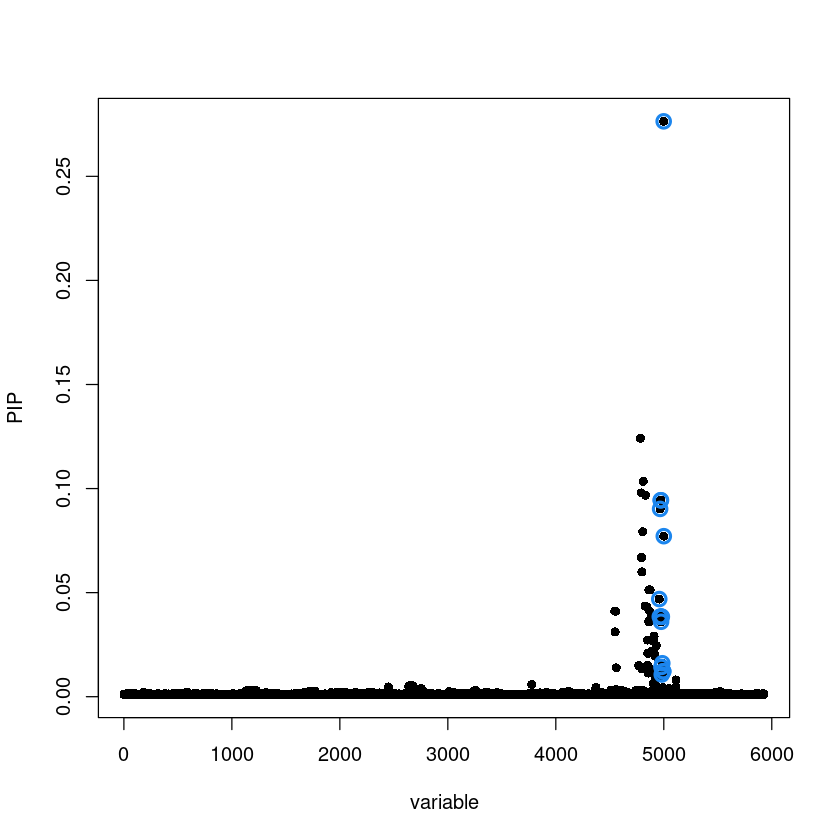

In [52]:
susieR::susie_plot(Aven$dlpfc_eqtl,"PIP")

In [59]:
eqtl

ERROR: Error in eval(expr, envir, enclos): object 'eqtl' not found


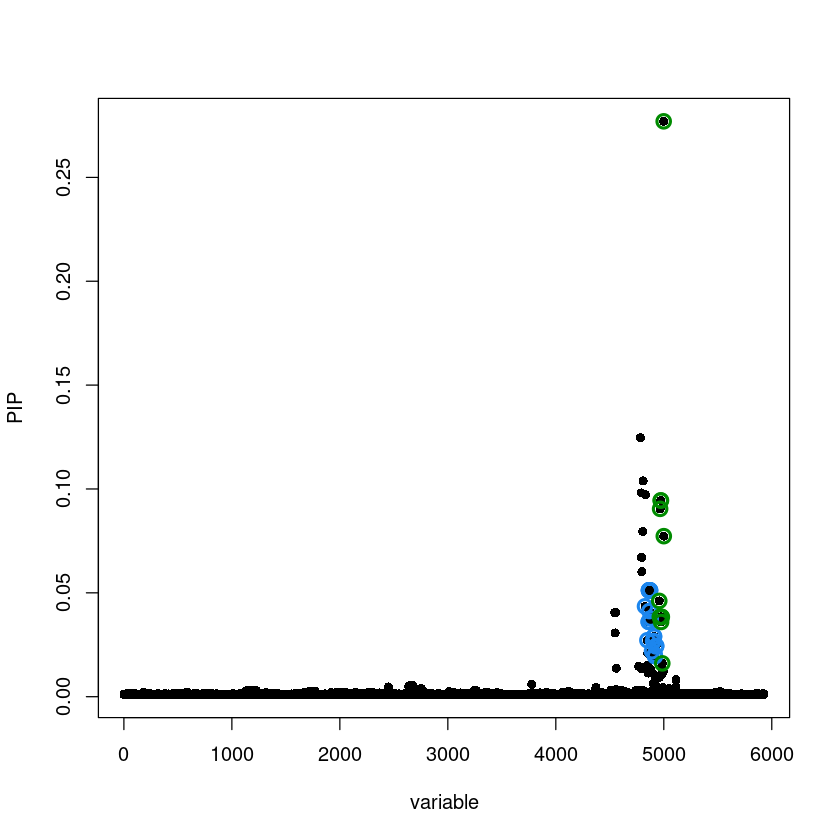

In [58]:
susieR::susie_plot(susieR::susie(Aven$dlpfc_eqtl$input_data$X_resid,Aven$dlpfc_eqtl$input_data$Y_resid,coverage = 0.91),"PIP")

In [62]:
shared = rbind(read_delim("4_1182_pip.tsv"),extract_table(Aven_tbl,"eQTL")%>%mutate(Shared = FALSE,molecular_trait_id = "eQTL_AVEN", new_CS = 0))%>%filter(Shared)%>%pull(snp)%>%unique

Rows: 23712 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: " "
chr (2): snp, molecular_trait_id
dbl (4): y, pos, CS, new_CS
lgl (1): Shared

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [64]:
Aven_tbl%>%filter(variants %in% shared)

variants,snps_index,chromosome,position,ref,alt,cs_order,cs_id,log10_base_factor,pip,posterior_mean,posterior_sd,z,molecular_trait_id,finemapped_region_start,finemapped_region_end
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
chr15:33137821_A_G,1920,15,33137821,A,G,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.957610e-05,0.0011084387,3.570436e-02,ENSG00000169857,32600000,34360000
chr15:33137845_C_T,1921,15,33137845,C,T,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000
chr15:33137871_G_A,1922,15,33137871,G,A,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000
chr15:33138029_A_G,1923,15,33138029,A,G,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000
chr15:33138447_C_T,1926,15,33138447,C,T,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.361544e-05,0.0011084387,3.032683e-02,ENSG00000169857,32600000,34360000
chr15:33138563_T_C,1927,15,33138563,T,C,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000
chr15:33138603_G_A,1928,15,33138603,G,A,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000
chr15:33138641_A_G,1929,15,33138641,A,G,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000
chr15:33138662_C_T,1930,15,33138662,C,T,0,None,0.603977291181985;0.0784423896574894;0.21633042456847;0.400159383181885;0.399521894487105;0.400700296454818;0.402783256942031;0.404856541570563;0.406180132214308;0.406245829928526,0.001772263,3.415098e-05,0.0011084387,3.080999e-02,ENSG00000169857,32600000,34360000


#### Check RYR2

In [1]:
RYR2 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad/cache/demo.ENSG00000198838.unisusie.fit.rds")

In [44]:
RYR2_tbl = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad//demo.ENSG00000198838.unisusie.fit.variant.tsv")

Rows: 5928 Columns: 16
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (6): variants, ref, alt, cs_id, log10_base_factor, molecular_trait_id
dbl (10): snps_index, chromosome, position, cs_order, pip, posterior_mean, p...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [61]:
extract_table = function(variant_df,type){ 
    if("purity" %in% colnames(variant_df) ){
      variant_df$purity[is.na(variant_df$purity)] = 0
      variant_df[abs(variant_df$purity) < 0.5,7] = 0
      }
     variant_df = variant_df%>%mutate(CS = (cs_order%>%as.factor%>%as.numeric-1)%>%as.factor)%>%
          select( y = pip ,snp = variants,pos = position , CS, molecular_trait_id)%>%mutate(molecular_trait_id = paste0(type,"_",molecular_trait_id ) )
    return(variant_df)
    }

In [51]:
read_delim("4_1182_pip.tsv")%>%head

Rows: 23712 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: " "
chr (2): snp, molecular_trait_id
dbl (4): y, pos, CS, new_CS
lgl (1): Shared

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


y,snp,pos,CS,molecular_trait_id,Shared,new_CS
<dbl>,<chr>,<dbl>,<dbl>,<chr>,<lgl>,<dbl>
1.209033e-13,chr15:32606430_C_G,32606430,0,mQTL_tad1182,FALSE,0
3.474998e-13,chr15:32606447_A_G,32606447,0,mQTL_tad1182,FALSE,0
1.604272e-13,chr15:32606610_G_C,32606610,0,mQTL_tad1182,FALSE,0
1.345590e-13,chr15:32606749_GAA_GAAA,32606749,0,mQTL_tad1182,FALSE,0
1.204592e-13,chr15:32607667_C_T,32607667,0,mQTL_tad1182,FALSE,0
1.894040e-13,chr15:32607691_C_A,32607691,0,mQTL_tad1182,FALSE,0


In [57]:
shared = rbind(read_delim("4_1182_pip.tsv"),extract_table(RYR2_tbl,"eQTL")%>%mutate(Shared = FALSE,molecular_trait_id = "eQTL_RYR3", new_CS = 0))%>%filter(Shared)%>%pull(snp)%>%unique

Rows: 23712 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: " "
chr (2): snp, molecular_trait_id
dbl (4): y, pos, CS, new_CS
lgl (1): Shared

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [60]:
rbind(read_delim("4_1182_pip.tsv"),extract_table(RYR2_tbl,"eQTL")%>%mutate(Shared = snp%in% shared,molecular_trait_id = "eQTL_RYR3", new_CS = 0))%>%write_delim("4_1182_pip.tsv_ryr3","\t")

Rows: 23712 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: " "
chr (2): snp, molecular_trait_id
dbl (4): y, pos, CS, new_CS
lgl (1): Shared

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [61]:
RYR2_tbl%>%filter(variants %in% shared)

variants,snps_index,chromosome,position,ref,alt,cs_order,cs_id,log10_base_factor,pip,posterior_mean,posterior_sd,z,molecular_trait_id,finemapped_region_start,finemapped_region_end
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
chr15:33137821_A_G,1920,15,33137821,A,G,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-2.900719e-05,0.0014323353,-2.025168e-02,ENSG00000198838,32600000,34360000
chr15:33137845_C_T,1921,15,33137845,C,T,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000
chr15:33137871_G_A,1922,15,33137871,G,A,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000
chr15:33138029_A_G,1923,15,33138029,A,G,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000
chr15:33138447_C_T,1926,15,33138447,C,T,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-3.112824e-05,0.0014323353,-2.173251e-02,ENSG00000198838,32600000,34360000
chr15:33138563_T_C,1927,15,33138563,T,C,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000
chr15:33138603_G_A,1928,15,33138603,G,A,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000
chr15:33138641_A_G,1929,15,33138641,A,G,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000
chr15:33138662_C_T,1930,15,33138662,C,T,0,None,-0.628011647086681;0.111537998979871;0.111655064596672;0.111666994283046;0.111398776315921;0.111110444427278;0.111052629010415;0.111212620554928;0.111441759290989;0.111602441114421,0.0016356102,-4.109775e-05,0.0014323353,-2.869283e-02,ENSG00000198838,32600000,34360000


In [65]:
which(RYR2$dlpfc_eqtl$variable_name%in% shared)

[1] 1920 1921 1922 1923 1926 1927 1928 1929 1930 1931 2522 2524 4783 4792 4797
[16] 4809 4816 4819 4820 4823 4824 4825 4831 4845 4852 4853 4854 4855 4857 4897
[31] 4902

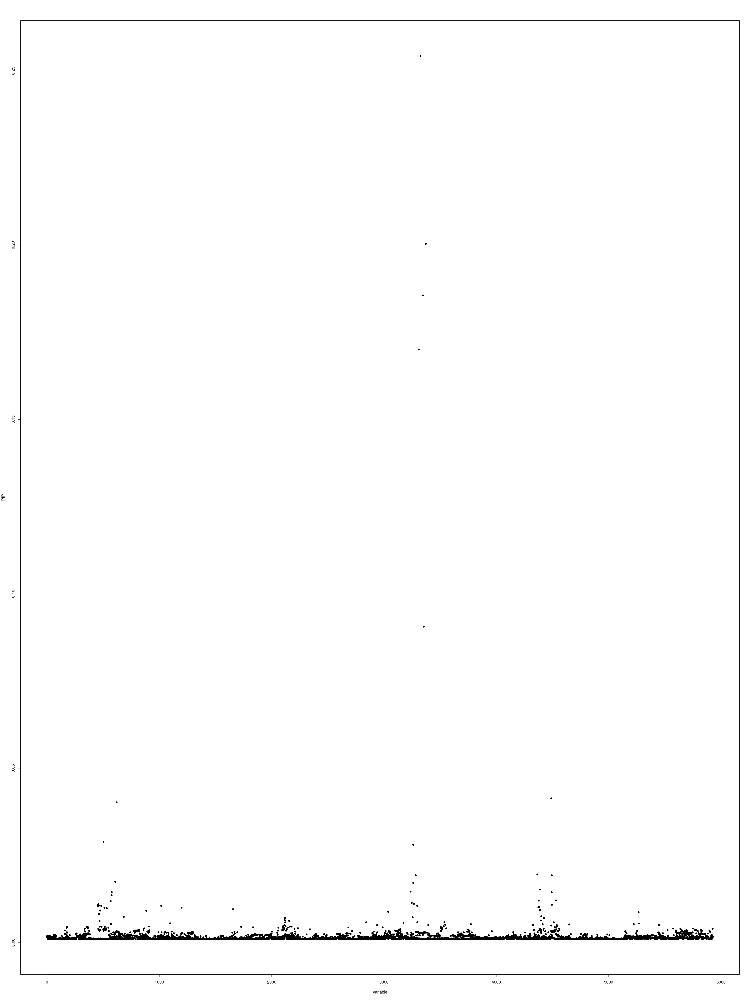

In [67]:
susieR::susie_plot(RYR2$dlpfc_eqtl,"PIP")

In [71]:
new_result = susieR::susie(RYR2$dlpfc_eqtl$input_data$X_resid,RYR2$dlpfc_eqtl$input_data$Y_resid,coverage = 0.9)

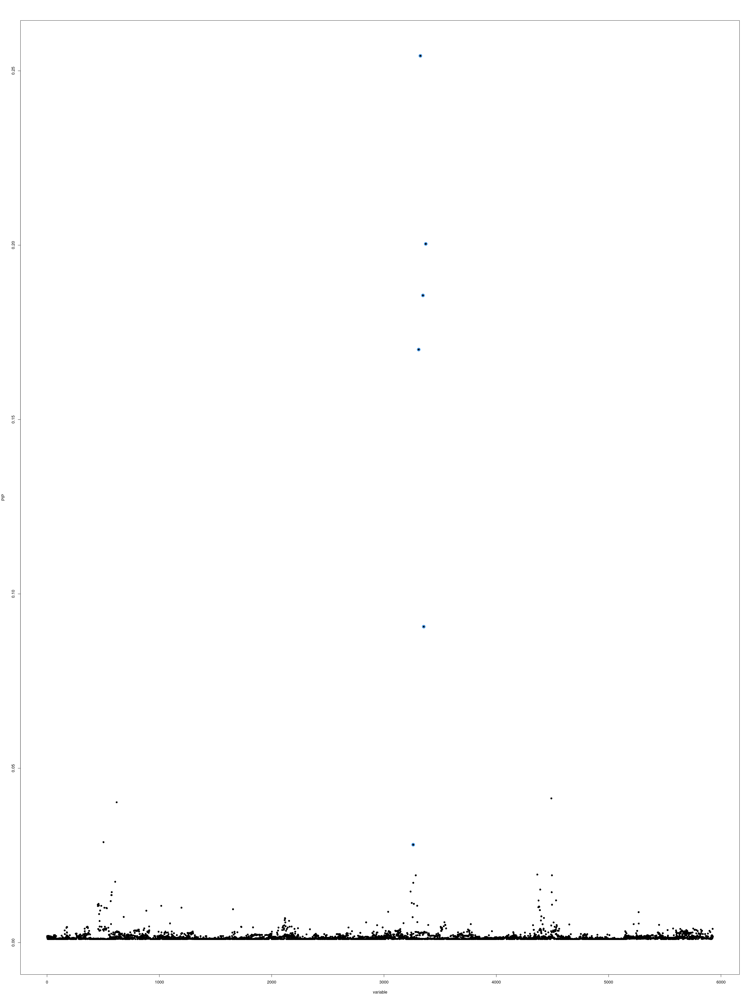

In [73]:
susieR::susie_plot(new_result,"PIP")

In [72]:
new_result$sets

,min.abs.corr,mean.abs.corr,median.abs.corr
,<dbl>,<dbl>,<dbl>
L1,0.5419729,0.8201854,0.9375179


### Check region for the boarder bands CS 3,4 for haQTL

In [35]:
features = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/reference_data/20221207_ddsvbasenji_data_files.feature_table.wg.txt","\t")

Rows: 9991229 Columns: 88
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): SNP
dbl (87): CHR, BP, CM, base, Coding_UCSC, Coding_UCSC.flanking.500, Conserve...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [36]:
head(features)

CHR,BP,SNP,CM,base,Coding_UCSC,Coding_UCSC.flanking.500,Conserved_LindbladToh,Conserved_LindbladToh.flanking.500,CTCF_Hoffman,⋯,Human_Promoter_Villar.flanking.500,Human_Enhancer_Villar,Human_Enhancer_Villar.flanking.500,Ancient_Sequence_Age_Human_Promoter,Ancient_Sequence_Age_Human_Promoter.flanking.500,Ancient_Sequence_Age_Human_Enhancer,Ancient_Sequence_Age_Human_Enhancer.flanking.500,Human_Enhancer_Villar_Species_Enhancer_Count,Human_Promoter_Villar_ExAC,Human_Promoter_Villar_ExAC.flanking.500
<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,11008,rs575272151,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
1,11012,rs544419019,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
1,13110,rs540538026,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
1,13116,rs62635286,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
1,13118,rs200579949,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
1,13273,rs531730856,0,1,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


In [ ]:
features%>%filter(CHR == 15 , BP >  32600000, 
                      BP <34360000 )%>%pivot_longer(cols = 6:ncol(features), names_to = "annotation", values_to = "value")%>%filter(value != 0, str_detect(annotation,"Enh"))%>%write_delim("4_1182_enhancer.tsv")

In [33]:
features%>%filter(CHR == 15 , BP > min(susiF_obj_ha$outing_grid[which(susiF_obj_ha$cred_band[[3]][2,] > 0)]) , 
                      BP < max(susiF_obj_ha$outing_grid[which(susiF_obj_ha$cred_band[[3]][2,] > 0)])   )%>%pivot_longer(cols = 6:ncol(features), names_to = "annotation", values_to = "value")%>%filter(value != 0, str_detect("Enh"))%>%
                        count(annotation)%>%filter(n>1000)%>%ggplot(aes(x = reorder(annotation,n), y = n )) +geom_col()+         theme(text = element_text(size = 40))+  
                        theme(plot.margin=unit(c(5,0,0,0),"mm"), strip.text.y.right = element_text(angle = 0,size = 20),axis.text.x = element_text(size = 25, angle = -45),axis.text.y = element_text(size = 25))

ERROR: Error in filter(., CHR == 15, BP > min(susiF_obj_ha$outing_grid[which(susiF_obj_ha$cred_band[[3]][2, : object 'features' not found


## Textbook example: TAD 808

In [1]:
color = c("black", "dodgerblue2", "green4", "#6A3D9A",
      "#FF7F00", "gold1", "skyblue2", "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")

In [2]:
pipplot = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/text_book/haQTL_mQTL_eQTL.tad808.pip_landscape_plot.rds")

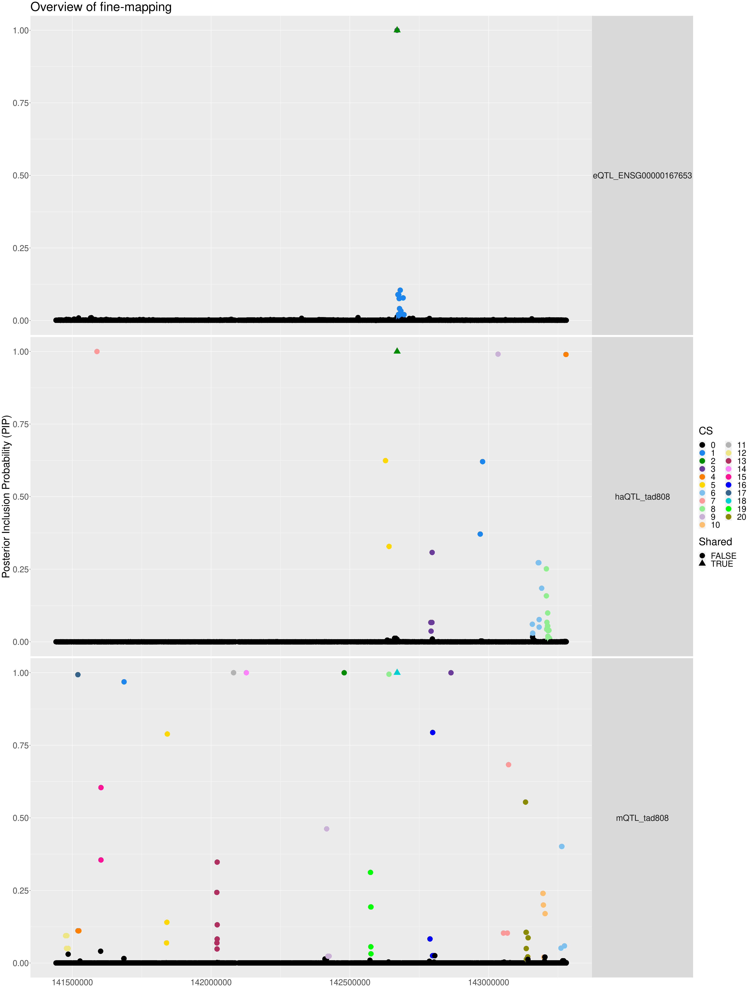

[[1]]

[[2]]
# A tibble: 18,663 × 6
            y snp                            pos CS    molecular_trait_id Shared
        <dbl> <chr>                        <dbl> <fct> <chr>              <lgl> 
 1 0.00000525 chr8:141441077_G_A       141441077 0     haQTL_tad808       FALSE 
 2 0.00000528 chr8:141441299_C_T       141441299 0     haQTL_tad808       FALSE 
 3 0.00000520 chr8:141442125_C_G       141442125 0     haQTL_tad808       FALSE 
 4 0.00000517 chr8:141442409_C_T       141442409 0     haQTL_tad808       FALSE 
 5 0.00000520 chr8:141442518_C_A       141442518 0     haQTL_tad808       FALSE 
 6 0.00000519 chr8:141442854_G_A       141442854 0     haQTL_tad808       FALSE 
 7 0.00000519 chr8:141442903_A_G       141442903 0     haQTL_tad808       FALSE 
 8 0.00000515 chr8:141443253_A_G       141443253 0     haQTL_tad808       FALSE 
 9 0.00000519 chr8:141443485_TA_CA     141443485 0     haQTL_tad808       FALSE 
10 0.00000519 chr8:141443550_G_GTTTTAT 141443550 0     haQTL_tad808      

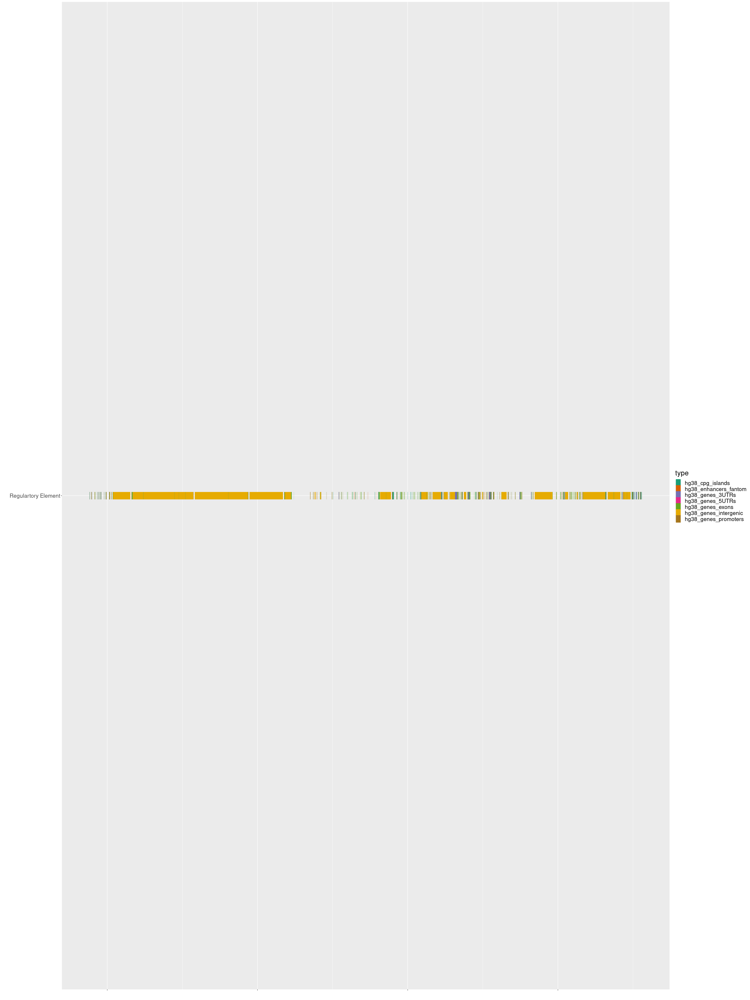

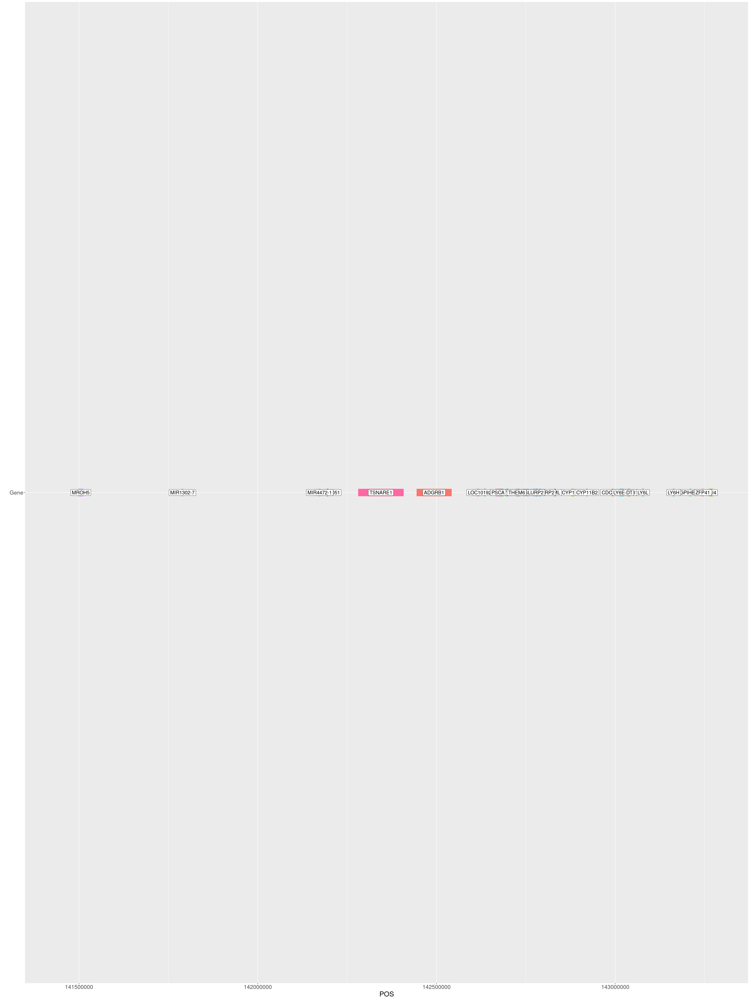

In [19]:
pipplot

In [4]:
plot_df = pipplot[[2]]

### Additional analysis 

In [5]:
plot_df%>%mutate(new_CS = case_when(molecular_trait_id == "mQTL_tad808" & CS == 18 ~  2,
                                    molecular_trait_id == "mQTL_tad808" & CS == 2 ~  18,
                                    .default = as.numeric(CS)-1 
                                   ), molecular_trait_id = str_replace(molecular_trait_id,"ENSG00000167653","PSCA")   ) -> plot_df_2

ERROR: Error in plot_df %>% mutate(new_CS = case_when(molecular_trait_id == "mQTL_tad808" & : could not find function "%>%"


In [10]:
plot_df%>%filter(CS != 0,Shared)

y,snp,pos,CS,molecular_trait_id,Shared
<dbl>,<chr>,<dbl>,<fct>,<chr>,<lgl>
1,chr8:142670280_T_C,142670280,2,haQTL_tad808,TRUE
1,chr8:142670280_T_C,142670280,18,mQTL_tad808,TRUE
1,chr8:142670280_T_C,142670280,2,eQTL_ENSG00000167653,TRUE


In [11]:
pQTL = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/pqtl.all_variants.tsv")

Rows: 36591872 Columns: 16
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): variants, ref, alt, cs_order, cs_id, log10_base_factor, molecular_t...
dbl (9): snps_index, chromosome, position, pip, posterior_mean, posterior_sd...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [13]:
pQTL%>%filter(variants == "chr8:142670280_T_C")

variants,snps_index,chromosome,position,ref,alt,cs_order,cs_id,log10_base_factor,pip,posterior_mean,posterior_sd,z,molecular_trait_id,finemapped_region_start,finemapped_region_end
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
chr8:142670280_T_C,4175,8,142670280,T,C,0,None,-0.0314589730711481;-0.0318470811648359;-0.0324517731373311;-0.0331065363142877;-0.033697634702393;-0.0341520203539358;-0.0344272522812348;-0.034503437622952;-0.0343769827098843;-0.0340553721988774,1.552192e-03,-4.330927e-06,0.0005731470,-0.007556398,8_ARC_Q7LC44,141614478,142614478
chr8:142670280_T_C,4175,8,142670280,T,C,0,None,-2.25733010232279;-1.28495014685528;-0.37480359906605;-0.0732721198081447;-0.0724504429107966;-0.0717992908603231;-0.0715199262779558;-0.0716872057009623;-0.072248535020276;-0.0730528957570107,1.090113e-03,-1.411310e-05,0.0009059639,-0.015577990,8_LY6H_O94772,142160710,143160710
chr8:142670280_T_C,4175,8,142670280,T,C,0,None,-0.678616475322955;0;0;0;0;0;0;0;0;0,8.967553e-06,5.107677e-07,0.0002142662,0.002383800,8_LYNX1_P0DP58,141777809,142777809
chr8:142670280_T_C,4175,8,142670280,T,C,0,None,-1.23599177397363;-0.327431399608479;-0.349502280878924;-0.364202673887344;-0.366858887508544;-0.361833047488401;-0.35356874944738;-0.344361208733036;-0.335168416545754;-0.32634826894359,9.858178e-04,1.340807e-05,0.0011284794,0.011881540,8_THEM6_Q8WUY1,141727222,142727222


In [15]:
eQTL %>%filter(variants == "chr8:142670280_T_C")

variants,snps_index,chromosome,position,ref,alt,cs_order,cs_id,log10_base_factor,pip,posterior_mean,posterior_sd,z,molecular_trait_id,finemapped_region_start,finemapped_region_end
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<lgl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
chr8:142670280_T_C,4175,8,142670280,T,C,c(L2 = 1),NA,-1.03698579659379;94.9720950488768;-1.77274678642824;-0.229382492067759;-0.240344961886575;-0.262246891741379;-0.281373570059382;-0.289596129663257;-0.284677223945479;-0.266927139524514,1,0.199666,0.02566013,7.781176,ENSG00000167653,141440000,143280000


In [12]:
eQTL = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/eqtl/output/susie_per_gene_tad/whole_genome_cs.eqtl",delim = "\t")

Rows: 392547 Columns: 16
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (6): variants, ref, alt, cs_order, log10_base_factor, molecular_trait_id
dbl (9): snps_index, chromosome, position, pip, posterior_mean, posterior_sd...
lgl (1): cs_id

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [24]:
meta_brain_trans = read_delim("~/tad808_trans_QTL.tsv")

Rows: 19231 Columns: 22
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (13): SNPName, ProbeName, CisTrans, SNPType, AlleleAssessed, DatasetsZSc...
dbl  (9): PValue, SNPChr, SNPChrPos, ProbeChr, ProbeCenterChrPos, OverallZSc...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [29]:
meta_brain_trans%>%arrange(PValue)

PValue,SNPName,SNPChr,SNPChrPos,ProbeName,ProbeChr,ProbeCenterChrPos,CisTrans,SNPType,AlleleAssessed,⋯,DatasetsZScores,DatasetsNrSamples,IncludedDatasetsMeanProbeExpression,IncludedDatasetsProbeExpressionVariance,HGNCName,IncludedDatasetsCorrelationCoefficient,Meta-Beta (SE),Beta (SE),FoldChange,FDR
<dbl>,<chr>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,⋯,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>
3.05135e-05,8:142670280:rs4736369:T_C,8,142670280,ENSG00000124253.11,20,57561110,trans,T/C,C,⋯,-,2757,-,-,PCK1,-,0.112393 (0.0269541),-,-,NaN
3.63711e-05,8:142670280:rs4736369:T_C,8,142670280,ENSG00000213085.10,1,159900165,trans,T/C,C,⋯,-,2757,-,-,CFAP45,-,-0.1113095 (0.0269557),-,-,NaN
7.76304e-05,8:142670280:rs4736369:T_C,8,142670280,ENSG00000164627.18,6,39725408,trans,T/C,C,⋯,-,2757,-,-,KIF6,-,0.1065498 (0.0269627),-,-,NaN
2.33600e-04,8:142670280:rs4736369:T_C,8,142670280,ENSG00000169258.7,5,176610156,trans,T/C,C,⋯,-,2757,-,-,GPRIN1,-,0.0992523 (0.0269728),-,-,NaN
3.58300e-04,8:142670280:rs4736369:T_C,8,142670280,ENSG00000064787.13,20,54070594,trans,T/C,C,⋯,-,2757,-,-,BCAS1,-,-0.0962767 (0.0269767),-,-,NaN
3.61400e-04,8:142670280:rs4736369:T_C,8,142670280,ENSG00000180205.4,20,45631284,trans,T/C,C,⋯,-,2757,-,-,WFDC9,-,0.0962248 (0.0269768),-,-,NaN
4.66300e-04,8:142670280:rs4736369:T_C,8,142670280,ENSG00000177791.12,10,73641474,trans,T/C,C,⋯,-,2757,-,-,MYOZ1,-,0.0944145 (0.0269791),-,-,NaN
4.70900e-04,8:142670280:rs4736369:T_C,8,142670280,ENSG00000185247.15,23,149688228,trans,T/C,C,⋯,-,2757,-,-,MAGEA11,-,0.0943442 (0.0269792),-,-,NaN
4.84100e-04,8:142670280:rs4736369:T_C,8,142670280,ENSG00000185681.13,9,122159908,trans,T/C,C,⋯,-,2757,-,-,MORN5,-,0.0941465 (0.0269795),-,-,NaN


In [30]:
abc = read_delim("./added_annotation/ABC_results_ASSOCIATIONS_ALL_CPM1_RK_12_2_20.csv.gz")

Rows: 7412021 Columns: 24
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (6): chr, TargetGene, TargetGene_name, PeakID, PeakID_seqnames, combo
dbl (18): start, end, activity_base, TargetGeneTSS, TargetGenePromoterActivi...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [61]:
annot = read_delim("Nott_annot_chr8.tsv",col_names = F)

Warning message:
“One or more parsing issues, call `problems()` on your data frame for details,
e.g.:
  dat <- vroom(...)
  problems(dat)”
Rows: 20646 Columns: 4
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): X1, X2, X4
dbl (1): X3

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [62]:
annot

X1,X2,X3,X4
<chr>,<chr>,<dbl>,<chr>
56545,chr8,546560,546942
56546,chr8,687908,688256
56547,chr8,701768,703149
56548,chr8,869152,869941
56549,chr8,1163253,1164314
56550,chr8,1258861,1259282
56551,chr8,1456028,1457628
56552,chr8,1701077,1701611
56553,chr8,1787487,1788301


In [42]:
effect = read_delim("4_808_effect.tsv")

Rows: 1280 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): #chr, effect, type
dbl (4): pos, mid, up, low

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [55]:
abc %>%filter(start < 142559138 , end > 142559138 )

Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”


chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>


In [65]:
map(effect%>%arrange(-abs(mid))%>%head(50)%>%pull(pos),~annot %>%filter(X3 < .x , X4%>%as.numeric > .x ))

Warning message:
“There was 1 warning in `filter()`.
ℹ In argument: `X4 %>% as.numeric > .x`.
Caused by warning in `X4 %>% as.numeric`:
! NAs introduced by coercion”
Warning message:
“There was 1 warning in `filter()`.
ℹ In argument: `X4 %>% as.numeric > .x`.
Caused by warning in `X4 %>% as.numeric`:
! NAs introduced by coercion”
Warning message:
“There was 1 warning in `filter()`.
ℹ In argument: `X4 %>% as.numeric > .x`.
Caused by warning in `X4 %>% as.numeric`:
! NAs introduced by coercion”
Warning message:
“There was 1 warning in `filter()`.
ℹ In argument: `X4 %>% as.numeric > .x`.
Caused by warning in `X4 %>% as.numeric`:
! NAs introduced by coercion”
Warning message:
“There was 1 warning in `filter()`.
ℹ In argument: `X4 %>% as.numeric > .x`.
Caused by warning in `X4 %>% as.numeric`:
! NAs introduced by coercion”
Warning message:
“There was 1 warning in `filter()`.
ℹ In argument: `X4 %>% as.numeric > .x`.
Caused by warning in `X4 %>% as.numeric`:
! NAs introduced by coercion”
Warn

X1,X2,X3,X4
<chr>,<chr>,<dbl>,<chr>
59061,chr8,0,143219680
132944,chr8,0,143221244
61626,chr8,0,143219597
X1,X2,X3,X4
<chr>,<chr>,<dbl>,<chr>
59061,chr8,0,143219680
132944,chr8,0,143221244
61626,chr8,0,143219597
X1,X2,X3,X4


In [59]:
map(effect%>%arrange(-abs(mid))%>%head()%>%pull(pos),~abc %>%filter(start < .x , end > .x ))

Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”
Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of r

chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score


In [41]:
abc%>%filter(chr == "chr8", start >141440000 , end <143280000   )%>%filter(str_detect(TargetGene_name,"P"))%>%count(TargetGene_name)


TargetGene_name,n
<chr>,<int>
BOP1,138
CPSF1,138
EPPK1,138
GPAA1,138
NAPRT,138
NRBP2,138
PARP10,138
PEG13,138
PLEC,138


chr,start,end,activity_base,TargetGene,TargetGene_name,TargetGeneTSS,TargetGenePromoterActivityQuantile,distance,PeakID,⋯,ABC.Score,powerlaw_contact,powerlaw_contact_reference,hic_contact,hic_contact_pl_scaled,hic_pseudocount,hic_contact_pl_scaled_adj,ABC.Score.Numerator,powerlaw.Score.Numerator,powerlaw.Score
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr9,41654276,41654775,1.572911,ENSG00000276412,NA,41652172,0.482024,2353.5,Peak_205727,⋯,0.414741,0.123436,0.123436,0.123436,0.123436,0.001229,0.124665,0.196087,0.194154,0.392708
chr21,46606023,46606522,3.415134,ENSG00000160307,S100B,46605208,0.835160,1064.5,Peak_110639,⋯,0.379657,0.123436,0.123436,0.123436,0.123436,0.001229,0.124665,0.425749,0.421551,0.436513
chr18,39317948,39318447,6.639321,ENSG00000283458,AC011139.1,39314240,0.813805,3957.5,Peak_76264,⋯,0.379411,0.123436,0.123436,0.123436,0.123436,0.001229,0.124665,0.827693,0.819532,0.405310
chr2,88866741,88867240,6.512708,ENSG00000211597,IGKJ1,88861923,0.734472,5067.5,Peak_90632,⋯,0.369218,0.122005,0.122005,0.123436,0.123436,0.001229,0.124665,0.811908,0.794581,0.403174
chr5,148826243,148826742,10.328502,ENSG00000169252,ADRB2,148825245,0.738829,1247.5,Peak_159483,⋯,0.362335,0.123436,0.123436,0.123436,0.123436,0.001229,0.124665,1.287605,1.274910,0.409686
chr1,144546494,144546993,4.213308,ENSG00000278099,RF00003,144551943,0.899021,5199.5,Peak_8485,⋯,0.355288,0.119306,0.119306,0.123436,0.123436,0.001229,0.124665,0.525253,0.502673,0.366364
chr7,102425754,102426253,7.433232,ENSG00000160991,ORAI2,102433106,0.886310,7102.5,Peak_184648,⋯,0.330464,0.090958,0.090958,0.123436,0.123436,0.001229,0.124665,0.926666,0.676111,0.307825
chr1,116504362,116504861,7.016290,ENSG00000224950,AL390066.1,116499212,0.766428,5399.5,Peak_7978,⋯,0.329322,0.115453,0.115453,0.123436,0.123436,0.001229,0.124665,0.874688,0.810049,0.354411
chr7,94658186,94658685,3.349805,ENSG00000127990,SGCE,94656572,0.699154,1863.5,Peak_184112,⋯,0.329167,0.123436,0.123436,0.123436,0.123436,0.001229,0.124665,0.417604,0.413487,0.427374


### Check that the swapping is right

In [77]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 2,molecular_trait_id == "mQTL_tad808" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>
2,3


In [78]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 18,molecular_trait_id == "mQTL_tad808" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>


In [79]:
plot_range

[1] 32600000 34360000

In [138]:
plot_range = c(min(plot_df_2$pos),max(plot_df_2$pos))

In [81]:
plot_df_2%>%count(molecular_trait_id)

molecular_trait_id,n
<chr>,<int>
eQTL_PSCA,6221
haQTL_tad808,6221
mQTL_tad808,6221


In [101]:
plot_df_2%>%write_delim("4_808_pip.tsv","\t")

In [139]:
plot_range

[1] 141441077 143279787

In [82]:
refine_plot = plot_df_2%>%filter(molecular_trait_id != "eQTL_AC009268.1")%>%ggplot2::ggplot(aes(y = y, x = pos,
                              col =  as.factor(new_CS), shape = Shared )) + facet_grid(molecular_trait_id ~.)+
  geom_point(size = 7) +
  scale_color_manual("CS",values = color) +theme_bw()+
  theme(axis.ticks.x = element_blank()) +
 ylab("Posterior Inclusion Probability (PIP)")+xlim(plot_range)+
  theme(axis.ticks.x = element_blank()) +
        theme(strip.text.y.right = element_text(angle = 0))+
        xlab("") +
        theme(text = element_text(size = 30))

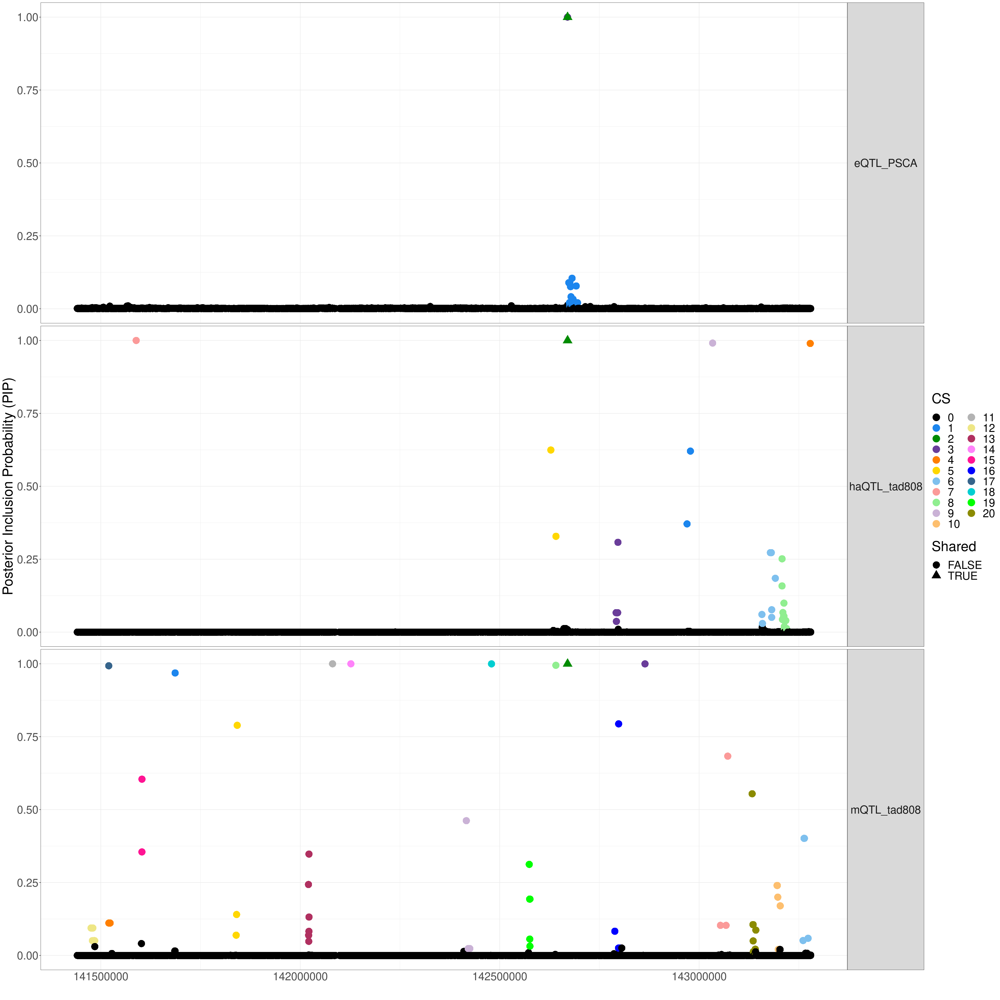

In [140]:
refine_plot

### For each CS of interest

In [183]:
susiF_obj_me =   readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_mQTL/meQTL.yuqi_mqtl.tad808.uni_Fsusie.mixture_normal_per_scale.rds")
susiF_obj_me = update_cal_credible_band2(susiF_obj_me)

In [184]:

susiF_obj_ha =  readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_haQTL/haQTL.rosmap_haqtl.tad808.uni_Fsusie.mixture_normal_per_scale.rds")
susiF_obj_ha = update_cal_credible_band2(susiF_obj_ha)

In [143]:
genotype = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/rerun/cache//fsusie.rosmap_haqtl.tad808.uni_Fsusie.mixture_normal_per_scale.rds")


In [144]:
genotype_me = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/rerun/cache//fsusie.yuqi_mqtl.tad808.uni_Fsusie.mixture_normal_per_scale.rds")


In [145]:
susiF_obj_me$input_data = genotype_me$input_data

In [146]:
head(susiF_obj_me$input_data[[1]])

,chr8:141441077_G_A,chr8:141441299_C_T,chr8:141442125_C_G,chr8:141442409_C_T,chr8:141442518_C_A,chr8:141442854_G_A,chr8:141442903_A_G,chr8:141443253_A_G,chr8:141443485_TA_CA,chr8:141443550_G_GTTTTAT,⋯,chr8:143277493_A_G,chr8:143278620_G_T,chr8:143278732_C_T,chr8:143279439_C_T,chr8:143279634_GT_G,chr8:143279644_C_CCTGCT,chr8:143279649_T_A,chr8:143279649_T_TCCGCA,chr8:143279727_C_T,chr8:143279787_C_A
SM-CTDSC,0.49993117,-1.0070858,-0.3860402,-0.5478814,0.67713326,0.68848702,0.68848702,0.003564517,0.68848702,0.677847121,⋯,0.7767400,0.3516872,0.3119791,-0.343688691,-0.069957579,0.05311427,0.05038246,-0.102334762,-0.069957579,-0.069957579
SM-CJFPD,-0.01927923,-0.6285197,1.0147297,2.1249427,0.03214301,0.01883853,0.01883853,-0.529028669,0.01883853,0.008540371,⋯,0.8537015,-0.8314337,-0.8267508,0.241511745,1.000816562,-0.15835906,-0.13957042,1.065663008,1.000816562,1.000816562
SM-CJIXK,0.43037534,-0.7593617,-0.4806297,-0.6107248,0.52069648,0.48754260,0.48754260,2.631916761,0.48754260,0.501721883,⋯,-0.8836490,-1.4256316,-1.3776147,0.103548292,0.008466997,-0.73839542,-0.73095617,0.395357683,0.008466997,0.008466997
SM-CTEET,1.62789784,-0.8896452,1.0880146,-0.3445168,1.74719605,1.71410095,1.71410095,-0.385222138,1.71410095,1.706283181,⋯,0.9217656,-0.7160032,-0.6527423,0.002052274,1.194396060,2.33331856,2.34115417,-0.076795312,1.194396060,1.194396060
SM-CJIYJ,-1.28705282,-0.8981804,-2.3736354,-0.5515488,-1.14712810,-1.15618610,-1.15618610,0.029178865,-1.15618610,-1.150510190,⋯,1.2282272,0.1128525,0.1392956,-0.398488975,0.380255049,-0.08213156,-0.06290323,0.407375991,0.380255049,0.380255049
SM-CTEMG,-1.39893678,1.3789396,-0.5427918,0.1187628,-1.45528140,-1.47285068,-1.47285068,-0.019824731,-1.47285068,-1.468337908,⋯,-0.7744593,-1.2567485,-1.1714673,-0.282904715,0.108249253,0.18529609,0.19785319,-0.002220899,0.108249253,0.108249253


In [147]:
susiF_obj_ha$input_data = genotype$input_data

In [148]:
susiF_obj_me$cs_selected = susiF_obj_me$cs[[18]]

In [149]:
susiF_obj_ha$cs_selected = susiF_obj_ha$cs[[2]]

In [150]:
list(haQTL = susiF_obj_ha, mQTL = list(cs =susiF_obj_me$cs  , cs_selected = susiF_obj_me$cs[[18]],input_data = genotype_me$input_data  ) )%>%saveRDS("tad808_fsusie_m_ha_cs_selected_result__input_data.rds")

In [151]:
list(haQTL = susiF_obj_ha, mQTL = susiF_obj_me )$haQTL$cs_selected

chr8:142670280_T_C 
              4175

In [152]:
susiF_obj_ha%>%saveRDS("tad808_fsusie_ha_cs_selected_result__input_data.rds")

In [153]:
susiF_obj_me%>%saveRDS("tad808_fsusie_m_cs_selected_result__input_data.rds")

In [154]:
intersect(names(susiF_obj_me),names(susiF_obj_ha)) == names(susiF_obj_ha)

Warning message in intersect(names(susiF_obj_me), names(susiF_obj_ha)) == names(susiF_obj_ha):
“longer object length is not a multiple of shorter object length”


[1]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[13]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[25]  TRUE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE

In [155]:
head(susiF_obj_me$input_data[[1]])

,chr8:141441077_G_A,chr8:141441299_C_T,chr8:141442125_C_G,chr8:141442409_C_T,chr8:141442518_C_A,chr8:141442854_G_A,chr8:141442903_A_G,chr8:141443253_A_G,chr8:141443485_TA_CA,chr8:141443550_G_GTTTTAT,⋯,chr8:143277493_A_G,chr8:143278620_G_T,chr8:143278732_C_T,chr8:143279439_C_T,chr8:143279634_GT_G,chr8:143279644_C_CCTGCT,chr8:143279649_T_A,chr8:143279649_T_TCCGCA,chr8:143279727_C_T,chr8:143279787_C_A
SM-CTDSC,0.49993117,-1.0070858,-0.3860402,-0.5478814,0.67713326,0.68848702,0.68848702,0.003564517,0.68848702,0.677847121,⋯,0.7767400,0.3516872,0.3119791,-0.343688691,-0.069957579,0.05311427,0.05038246,-0.102334762,-0.069957579,-0.069957579
SM-CJFPD,-0.01927923,-0.6285197,1.0147297,2.1249427,0.03214301,0.01883853,0.01883853,-0.529028669,0.01883853,0.008540371,⋯,0.8537015,-0.8314337,-0.8267508,0.241511745,1.000816562,-0.15835906,-0.13957042,1.065663008,1.000816562,1.000816562
SM-CJIXK,0.43037534,-0.7593617,-0.4806297,-0.6107248,0.52069648,0.48754260,0.48754260,2.631916761,0.48754260,0.501721883,⋯,-0.8836490,-1.4256316,-1.3776147,0.103548292,0.008466997,-0.73839542,-0.73095617,0.395357683,0.008466997,0.008466997
SM-CTEET,1.62789784,-0.8896452,1.0880146,-0.3445168,1.74719605,1.71410095,1.71410095,-0.385222138,1.71410095,1.706283181,⋯,0.9217656,-0.7160032,-0.6527423,0.002052274,1.194396060,2.33331856,2.34115417,-0.076795312,1.194396060,1.194396060
SM-CJIYJ,-1.28705282,-0.8981804,-2.3736354,-0.5515488,-1.14712810,-1.15618610,-1.15618610,0.029178865,-1.15618610,-1.150510190,⋯,1.2282272,0.1128525,0.1392956,-0.398488975,0.380255049,-0.08213156,-0.06290323,0.407375991,0.380255049,0.380255049
SM-CTEMG,-1.39893678,1.3789396,-0.5427918,0.1187628,-1.45528140,-1.47285068,-1.47285068,-0.019824731,-1.47285068,-1.468337908,⋯,-0.7744593,-1.2567485,-1.1714673,-0.282904715,0.108249253,0.18529609,0.19785319,-0.002220899,0.108249253,0.108249253


### Get the right original CS`$haQTL$`

In [185]:
 output_me = effect_extract_df(susiF_obj_me,n = c(18))
 output_ha = effect_extract_df(susiF_obj_ha,n = c(2))


New names:
• `` -> `...1`
New names:
• `` -> `...1`


### Gene plot

In [158]:
gene_name = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.region_list")
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 60726 Columns: 5
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): #chr, gene_id, gene_name
dbl (2): start, end

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [159]:
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [160]:
gene_body%>%filter(X4 ==  c(142670308)| X5 == 142670308 , X3 == "gene")

X1,X2,X3,X4,X5,X6,X7,X8,X9
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
chr8,ensembl_havana,gene,142670308,142682725,.,+,.,"gene_id ""ENSG00000167653""; transcript_id ""ENSG00000167653""; gene_type ""protein_coding""; gene_name ""PSCA""; transcript_type ""protein_coding""; transcript_name ""PSCA""; gene_version ""5""; gene_source ""ensembl_havana"";"


In [161]:
gene_info = gene_name%>%filter(gene_id %in% c("ENSG00000167653"))%>%mutate(end = c(142682725 ), strand = c(1) )%>%mutate(plot_group = c(1))

In [162]:
gene_info%>%mutate(dist = start-end)

#chr,start,end,gene_id,gene_name,strand,plot_group,dist
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
chr8,142670307,142682725,ENSG00000167653,PSCA,1,1,-12418


In [163]:
gene_info%>%write_delim("4_808_gene.tsv")

In [164]:
gene_info%>%                ggplot(aes()) + geom_segment( aes(x = start,xend = end, y = "", yend = "" ) , arrow = arrow(length = unit(0.5, "cm")) )+theme_bw()+
                            ylab("")+xlab("")+geom_label(aes(x = (start)-70000,y = "", label = gene_name,group =  plot_group ), position = position_dodge(width = 1),size = 10)+
                            theme(legend.position="none")+theme(text = element_text(size = 10))+xlim(plot_range)+geom_point(aes(x = start, y = ""), color = "black",size = 3  )+ylab("")+xlab("") -> gene_plot

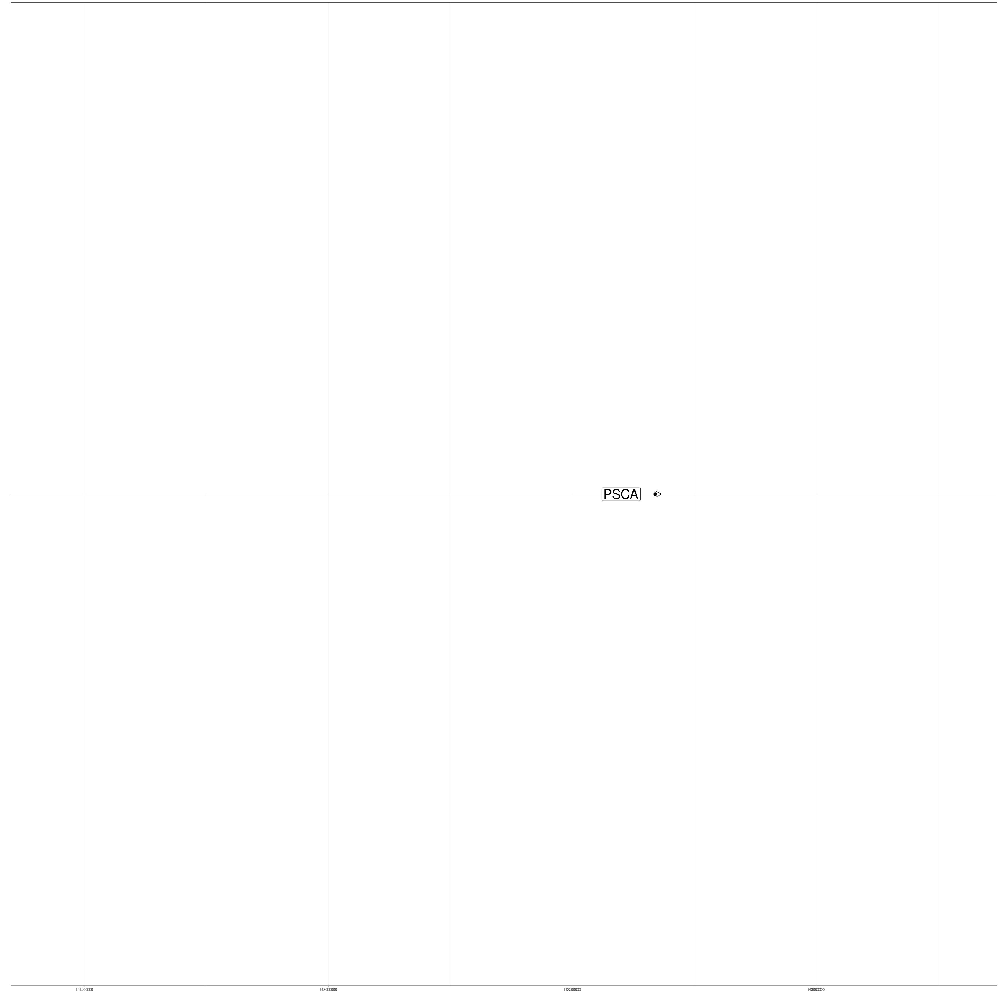

In [165]:
gene_plot

In [166]:
gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905"))%>%mutate(end = c(32765544,34067458 ), strand = c(2,1) )%>%mutate(plot_group = c(1,2))%>%
                            ggplot(aes()) + geom_segment( aes(x = start,xend = end, y = "", yend = "" ) , arrow = arrow(length = unit(0.5, "cm")) )+
                            geom_label(aes(x = (start),y = "1", label = gene_name), position = position_dodge(width = 10),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_blank())+xlim(plot_range)+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) -> gene_plot 

In [167]:
gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000259505"))

#chr,start,end,gene_id,gene_name
<chr>,<dbl>,<dbl>,<chr>,<chr>
chr15,33194713,33194714,ENSG00000248905,FMN1
chr15,33968496,33968497,ENSG00000184984,CHRM5
chr15,33990685,33990686,ENSG00000259505,AC009268.1


### Swapping the name

In [168]:
mapper = c("Effect_18"  =   "Effect_2" ,
"Effect_4"  =   "Effect_9" ,
"Effect_2"  =   "Effect_18" ,
"Effect_1"  =   "Effect_7","Effect_6" = "Effect_6")

In [173]:
mapper

Effect_18    Effect_4    Effect_2    Effect_1    Effect_6 
 "Effect_2"  "Effect_9" "Effect_18"  "Effect_7"  "Effect_6"

In [186]:
output_me = output_me%>%mutate(effect = map_chr(effect,~names(mapper[which(mapper == .x)])))

In [187]:
output_me = output_me%>%mutate(type = paste0("mQTL_" , effect ))
output_ha = output_ha%>%mutate(type = paste0( "haQTL_",effect ))
                              

In [188]:
min(output_me$pos)

[1] 141444864

In [189]:
min(output_ha$pos)

[1] 141549510

In [190]:
n = c(1,2,3,4)

### Plotting refine CS plot

## Refine plot for tad 435

In [14]:
pipplot = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/text_book/haQTL_mQTL_eQTL.tad435.pip_landscape_plot.rds")

In [15]:
options(repr.plot.width =30, repr.plot.height = 40)

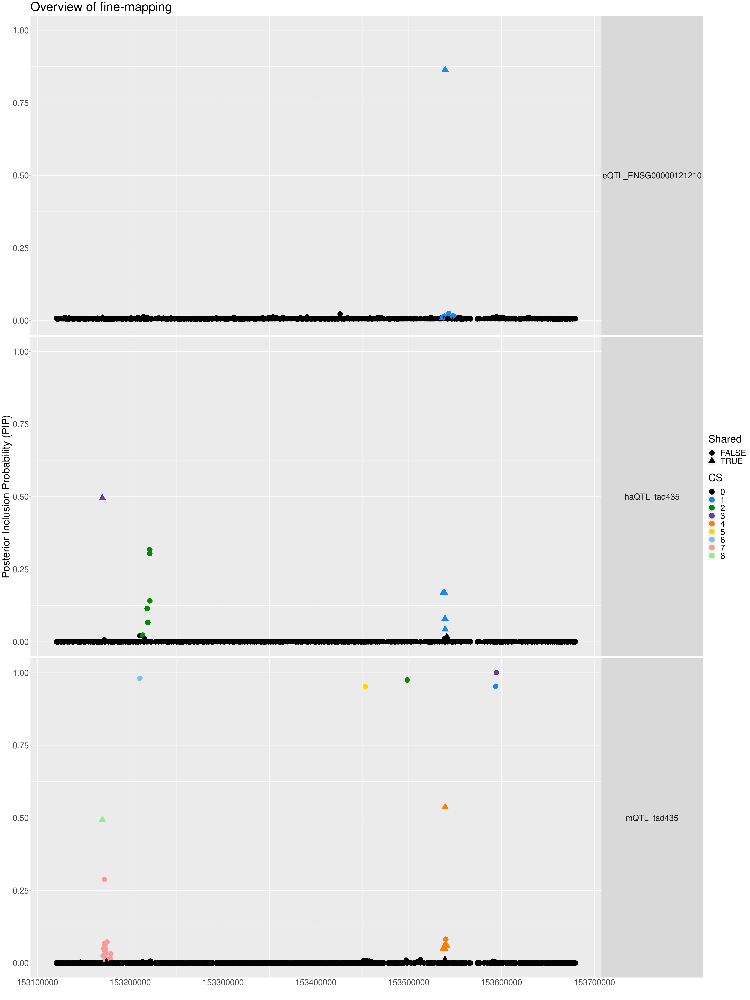

In [16]:
pipplot[[1]]

In [17]:
plot_df = pipplot[[2]]

In [60]:
plot_df%>%count(molecular_trait_id)

molecular_trait_id,n
<chr>,<int>
eQTL_ENSG00000121210,1354
haQTL_tad435,1354
mQTL_tad435,1354


In [57]:
plot_df%>%mutate(new_CS = case_when(molecular_trait_id == "mQTL_tad435" & CS == 1 ~  11,
                                    molecular_trait_id == "mQTL_tad435" & CS == 4 ~  1,
                                    molecular_trait_id == "mQTL_tad435" & CS == 8 ~  3,
                                    .default = as.numeric(CS)-1 
                                   ), molecular_trait_id = str_replace(molecular_trait_id,"ENSG00000121210","TMEM131L")%>%str_replace("ENSG00000184984","CHRM5")%>%str_replace("ENSG00000259505","AC009268.1")   ) -> plot_df_2

ERROR: Error in mutate(., new_CS = case_when(molecular_trait_id == "mQTL_tad435" & : object 'plot_df' not found


In [74]:
plot_df_2%>%count(molecular_trait_id,CS)

molecular_trait_id,CS,n
<chr>,<fct>,<int>
eQTL_TMEM131L,0,1339
eQTL_TMEM131L,1,15
haQTL_tad435,0,1339
haQTL_tad435,1,7
haQTL_tad435,2,6
haQTL_tad435,3,2
mQTL_tad435,0,1319
mQTL_tad435,1,1
mQTL_tad435,2,1


### Check that the swapping is right

In [75]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 1,molecular_trait_id == "meQTL_tad435" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>


In [76]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 2,molecular_trait_id == "meQTL_tad435" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>


In [77]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 3,molecular_trait_id == "meQTL_tad435" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>


In [78]:
plot_df_2%>%filter(snp %in% (plot_df_2%>%filter(Shared,new_CS == 4,molecular_trait_id == "meQTL_tad435" )%>%pull(snp)))%>%count(new_CS)

new_CS,n
<dbl>,<int>


In [79]:
plot_df_2 = plot_df_2%>%mutate(molecular_trait_id = ifelse(molecular_trait_id == "meQTL_tad435", "mQTL_tad435",molecular_trait_id ))

In [80]:
plot_df_2%>%count(molecular_trait_id)

molecular_trait_id,n
<chr>,<int>
eQTL_TMEM131L,1354
haQTL_tad435,1354
mQTL_tad435,1354


In [81]:
plot_df_2%>%filter(Shared)

y,snp,pos,CS,molecular_trait_id,Shared,new_CS
<dbl>,<chr>,<dbl>,<fct>,<chr>,<lgl>,<dbl>
4.951215e-01,chr4:153169893_G_A,153169893,3,haQTL_tad435,TRUE,3
4.951215e-01,chr4:153169959_C_T,153169959,3,haQTL_tad435,TRUE,3
1.672374e-01,chr4:153536903_C_T,153536903,1,haQTL_tad435,TRUE,1
1.672374e-01,chr4:153537319_AAG_A,153537319,1,haQTL_tad435,TRUE,1
1.672374e-01,chr4:153538553_C_CT,153538553,1,haQTL_tad435,TRUE,1
1.672374e-01,chr4:153538806_C_G,153538806,1,haQTL_tad435,TRUE,1
1.672374e-01,chr4:153538959_C_T,153538959,1,haQTL_tad435,TRUE,1
7.989376e-02,chr4:153539093_G_A,153539093,1,haQTL_tad435,TRUE,1
1.816364e-09,chr4:153539263_G_A,153539263,0,haQTL_tad435,TRUE,0


In [82]:
plot_range = plot_range = c(min(plot_df_2$pos),max(plot_df_2$pos))

In [83]:
refine_plot = plot_df_2%>%filter(molecular_trait_id != "eQTL_AC009268.1")%>%ggplot2::ggplot(aes(y = y, x = pos,
                              col =  as.factor(new_CS), shape = Shared )) + facet_grid(molecular_trait_id ~.)+
  geom_point(size = 7) +
  scale_color_manual("CS",values = color) +theme_bw()+
  theme(axis.ticks.x = element_blank()) +
 ylab("Posterior Inclusion Probability (PIP)")+xlim(plot_range)+
  theme(axis.ticks.x = element_blank()) +
        theme(strip.text.y.right = element_text(angle = 0))+
        xlab("") +
        theme(text = element_text(size = 30))

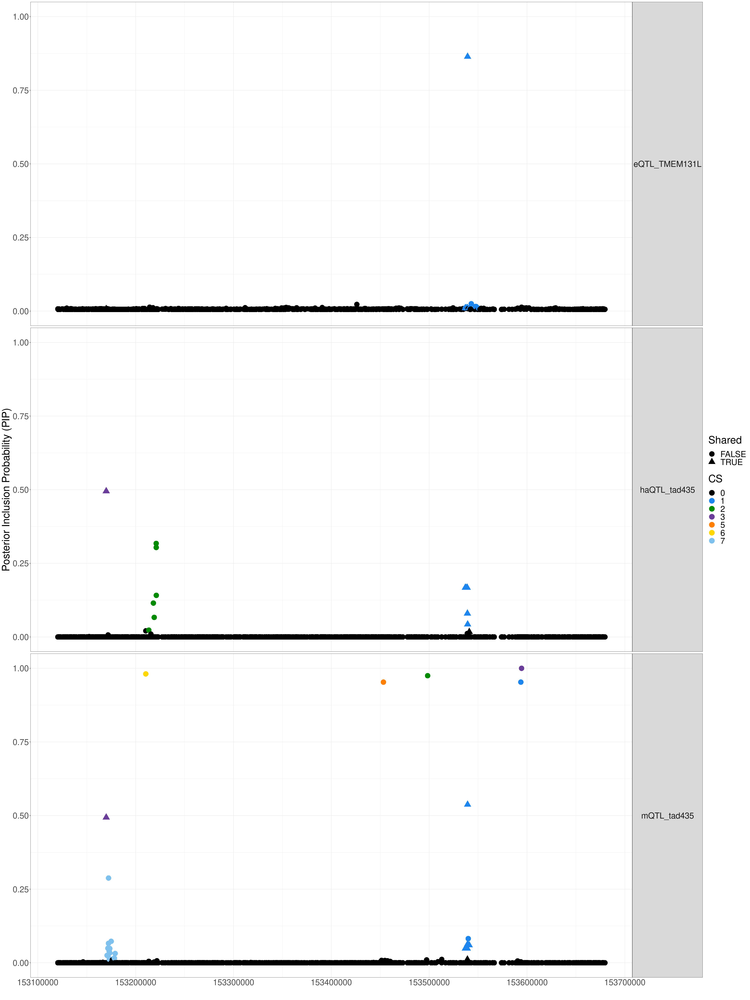

In [84]:
refine_plot

### For each CS of interest

In [56]:
susiF_obj_me$cs

[[1]]
chr4:153593695_T_C 
              1102 

[[2]]
chr4:153498419_T_A 
               993 

[[3]]
chr4:153594426_AC_A 
               1110 

[[4]]
  chr4:153539263_G_A   chr4:153539930_G_T   chr4:153539319_A_G 
                1037                 1040                 1038 
  chr4:153540978_C_G   chr4:153536903_C_T chr4:153537319_AAG_A 
                1043                 1028                 1030 
 chr4:153538553_C_CT   chr4:153538806_C_G   chr4:153538959_C_T 
                1031                 1033                 1035 

[[5]]
chr4:153453257_T_G 
               899 

[[6]]
chr4:153210363_G_C 
               315 

[[7]]
      chr4:153172312_C_T chr4:153175012_GTTTTGT_G      chr4:153175016_TG_* 
                     189                      202                      203 
      chr4:153172256_T_C      chr4:153171640_GA_G       chr4:153173523_G_A 
                     188                      178                      198 
      chr4:153173530_C_T       chr4:153172849_A_G       chr4:153172955_G_C 
                     199                      192                      194 
      chr4:153172957_G_C       chr4:153173641_C_T       chr4:153179048_A_G 
                     195                      200                      219 
      chr4:153170803_T_C    chr4:153171649_GATA_G       chr4:153171656_C_T 
                     177                      179                      180 
      chr4:153178130_T_C       chr4:153178346_T_C       chr4:153173921_T_C 
                     215                      217                      201 
      chr4:153173083_C_G 
                     197 

[[8]]
chr4:153169893_G_A chr4:153169959_C_T 
               172                173

In [29]:
susiF_obj_me =   readRDS("~/GIT/neuro-mQTL/notebook/refined_4_435_mQTL.rds")
susiF_obj_me = update_cal_credible_band2(susiF_obj_me)

ERROR: Error in readRDS("~/GIT/neuro-mQTL/notebook/refined_4_435_mQTL.rds"): unknown input format


In [30]:
susiF_obj_ha =  attach("refined_4_435_haQTL.rds")


In [ ]:
susiF_obj_ha$haQTL_res

In [25]:

susiF_obj_ha =  attach("refined_4_435_haQTL.rds")
susiF_obj_ha = update_cal_credible_band2(susiF_obj_ha)

ERROR: Error in readRDS("refined_4_435_haQTL.rds"): unknown input format


In [87]:
susiF_obj_me$cs

[[1]]
chr4:153593695_T_C 
              1102 

[[2]]
chr4:153498419_T_A 
               993 

[[3]]
chr4:153594426_AC_A 
               1110 

[[4]]
  chr4:153539263_G_A   chr4:153539930_G_T   chr4:153539319_A_G 
                1037                 1040                 1038 
  chr4:153540978_C_G   chr4:153536903_C_T chr4:153537319_AAG_A 
                1043                 1028                 1030 
 chr4:153538553_C_CT   chr4:153538806_C_G   chr4:153538959_C_T 
                1031                 1033                 1035 

[[5]]
chr4:153453257_T_G 
               899 

[[6]]
chr4:153210363_G_C 
               315 

[[7]]
      chr4:153172312_C_T chr4:153175012_GTTTTGT_G      chr4:153175016_TG_* 
                     189                      202                      203 
      chr4:153172256_T_C      chr4:153171640_GA_G       chr4:153173523_G_A 
                     188                      178                      198 
      chr4:153173530_C_T       chr4:153172849_A_G       chr4:153172955_G_C 
                     199                      192                      194 
      chr4:153172957_G_C       chr4:153173641_C_T       chr4:153179048_A_G 
                     195                      200                      219 
      chr4:153170803_T_C    chr4:153171649_GATA_G       chr4:153171656_C_T 
                     177                      179                      180 
      chr4:153178130_T_C       chr4:153178346_T_C       chr4:153173921_T_C 
                     215                      217                      201 
      chr4:153173083_C_G 
                     197 

[[8]]
chr4:153169893_G_A chr4:153169959_C_T 
               172                173

In [36]:
effect_extract = function(fsusie,n = 1:length(fsusie$fitted_func) ){
     plot_df = ((fsusie$fitted_func[n])%>%as_tibble(.name_repair = "universal")%>%mutate(pos =  fsusie$outing_grid)%>%`colnames<-`(c(paste0("Effect_",n),"pos"))%>%mutate(`#chr` = str_split(names(fsusie$csd_X)[[1]],":")[[1]][[1]] ))%>%dplyr::select(`#chr`, pos, everything())
     plot=  plot_df%>%pivot_longer(cols = 3:ncol(plot_df),names_to = "effect", values_to = "values"   ) %>%ggplot(aes(x = pos, y = values,color = effect),linewidth = 7)+
     geom_line()+ylab("Estimated Effect") + xlab("POS")+facet_grid(effect~. )+
         scale_color_manual("Credible set",values = color[n+1])+geom_line(aes(y = 0), color = "black")+
         theme(strip.text.y.right = element_text(angle = 0))+
         xlab("") + 
         ylab("Estimated Effect")+ 
         theme(text = element_text(size = 50))+
         ggtitle(paste0( "Estimated effect for ${f'{_input:br}'.split('.')[-4]}"))
     return(list(plot_df,plot))
     }




In [89]:
 output_me = effect_extract_df(susiF_obj_me,n = c(1,3))

New names:
• `` -> `...1`
• `` -> `...2`


### Use updated cs

In [38]:
susiF_obj_me =   attach("refined_4_435_mQTL.rds")$mQTL_res
susiF_obj_me = update_cal_credible_band2(susiF_obj_me)
susiF_obj_ha =  attach("refined_4_435_haQTL.rds")$haQTL_res
susiF_obj_ha = update_cal_credible_band2(susiF_obj_ha)

The following object is masked from file:refined_4_435_mQTL.rds (pos = 4):

    mQTL_res


The following object is masked from file:refined_4_435_mQTL.rds (pos = 5):

    mQTL_res


The following object is masked from file:refined_4_435_haQTL.rds (pos = 4):

    haQTL_res


The following object is masked from file:refined_4_435_haQTL.rds (pos = 7):

    haQTL_res




### Get the right original CS

In [39]:
 output_me = effect_extract_df(susiF_obj_me,n = c(4,8))
 output_ha = effect_extract_df(susiF_obj_ha,n = c(1,3))


New names:
• `` -> `...1`
• `` -> `...2`
New names:
• `` -> `...1`
• `` -> `...2`


### Gene plot

In [93]:
gene_name = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.region_list")
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 60726 Columns: 5
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): #chr, gene_id, gene_name
dbl (2): start, end

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [37]:
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


hr15	33194713	33194714	ENSG00000248905	FMN1
chr15	33968496	33968497	ENSG00000184984	CHRM5
chr15	33990685	33990686	ENSG00000259505	AC009268.1


In [94]:
gene_exom = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 3073921 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [95]:
gene_exom = gene_exom %>%filter(X1 == "chr4", X4 >= plot_range[[1]], X5 <=  plot_range[[2]])

In [99]:
gene_exom%>%filter(X3 == "gene", X2 == "ensembl_havana")

X1,X2,X3,X4,X5,X6,X7,X8,X9
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
chr4,ensembl_havana,gene,153152163,153339319,.,+,.,"gene_id ""ENSG00000109654""; gene_version ""16""; gene_name ""TRIM2""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding"";"
chr4,ensembl_havana,gene,153344649,153415118,.,+,.,"gene_id ""ENSG00000121211""; gene_version ""8""; gene_name ""MND1""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding"";"
chr4,ensembl_havana,gene,153466346,153636711,.,+,.,"gene_id ""ENSG00000121210""; gene_version ""16""; gene_name ""TMEM131L""; gene_source ""ensembl_havana""; gene_biotype ""protein_coding"";"


In [100]:
exom = gene_exom%>%filter(str_detect(X9, c("ENSG00000109654"))| str_detect(X9,"ENSG00000121211") | str_detect(X9, "ENSG00000121210") )%>%filter(X3 == "exon")

In [101]:
exom%>%write_delim("4_435_gene_exom.tsv","\t")

In [44]:
gene_info = gene_name%>%filter(gene_id %in% c("ENSG00000184984","ENSG00000248905","ENSG00000259505","ENSG00000198838"))

In [105]:
gene_info = gene_name%>%filter(gene_id %in% c("ENSG00000109654","ENSG00000121211","ENSG00000121210"))

In [109]:
gene_info = gene_name%>%filter(gene_id %in% c("ENSG00000109654","ENSG00000121211","ENSG00000121210"))%>%mutate(end = c(153339319,153415118,153636711 ), strand = c(1,1,1) )%>%mutate(plot_group = c(2,2,2))

In [110]:
gene_info%>%mutate(dist = start-end)

#chr,start,end,gene_id,gene_name,strand,plot_group,dist
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
chr4,153152162,153339319,ENSG00000109654,TRIM2,1,2,-187157
chr4,153344648,153415118,ENSG00000121211,MND1,1,2,-70470
chr4,153466345,153636711,ENSG00000121210,TMEM131L,1,2,-170366


In [111]:
gene_plot = gene_name%>%filter(gene_id %in% c("ENSG00000109654","ENSG00000121211","ENSG00000121210"))%>%mutate(plot_group = c(2,1,2))%>%
                            ggplot(aes())+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) + 
                            geom_label(aes(x = (start),y = "", label = gene_name,
                                           group =  plot_group ), position = position_dodge(width = 1),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_text(size = 10), axis.text.x = element_blank())+xlim(plot_range)

In [112]:
gene_info%>%
                            ggplot(aes()) + geom_segment( aes(x = start,xend = end, y = "", yend = "" ) , arrow = arrow(length = unit(0.5, "cm")) )+theme_bw()+
                            geom_label(aes(x = (start),y = "", label = gene_name,group =  plot_group ), position = position_dodge(width = 1),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_text(size = 10))+xlim(plot_range)+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) -> gene_plot

In [114]:
gene_info%>%write_delim("4_435_gene.tsv","\t")

In [115]:
gene_info

#chr,start,end,gene_id,gene_name,strand,plot_group
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>
chr4,153152162,153339319,ENSG00000109654,TRIM2,1,2
chr4,153344648,153415118,ENSG00000121211,MND1,1,2
chr4,153466345,153636711,ENSG00000121210,TMEM131L,1,2


In [117]:

gene_info%>%filter(gene_id %in% c("ENSG00000109654","ENSG00000121211","ENSG00000121210"))%>%
                            ggplot(aes()) + geom_segment( aes(x = start,xend = end, y = "", yend = "" ) , arrow = arrow(length = unit(0.5, "cm")) )+
                            geom_label(aes(x = (start),y = "1", label = gene_name), position = position_dodge(width = 10),size = 10)+ylab("")+xlab("")+
                            theme(legend.position="none")+theme(text = element_blank())+xlim(plot_range)+geom_point(aes(x = start, y = ""), color = "black",size = 3  ) -> gene_plot 

Rows: 843 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Warning message:
“Removed 843 rows containing missing values (`geom_segment()`).”


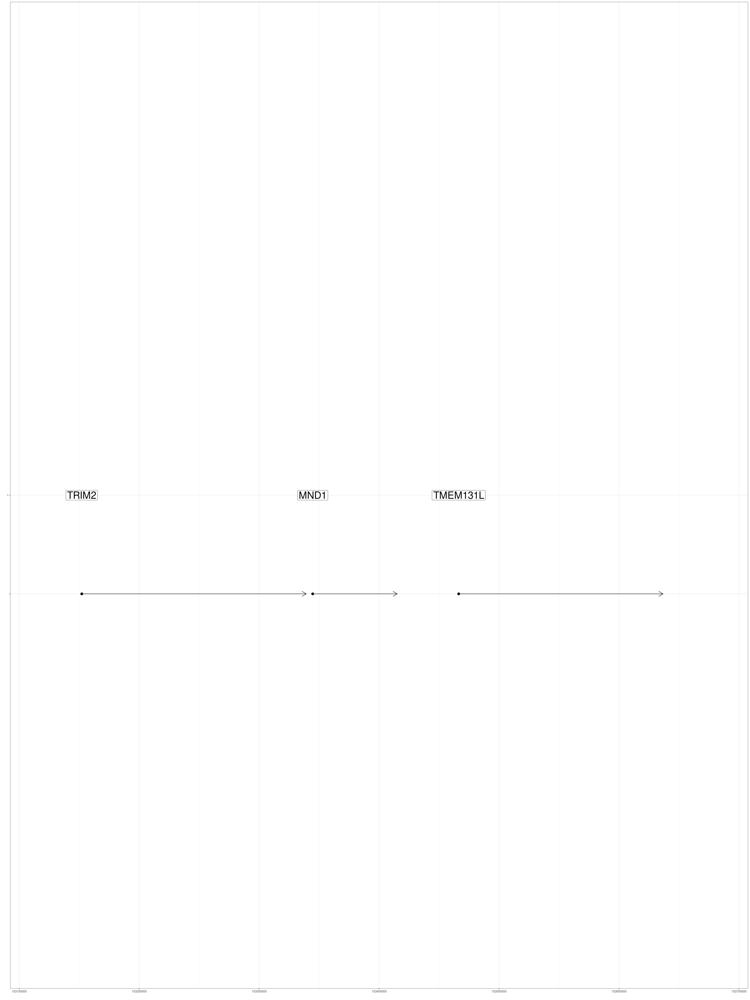

In [118]:
gene_plot+theme_bw()+geom_segment( aes(x = X4,xend = X5, y = "", yend = "" ),size  = 3, data = read_delim("4_435_gene_exom_ryr3.tsv","\t"))

### Swapping the name

In [40]:
mapper = c("Effect_3"  =   "Effect_8" ,
"Effect_1"  =   "Effect_4" )

In [41]:
names(mapper[which(mapper == "Effect_3")])

character(0)

In [42]:
output_me = output_me%>%mutate(effect = map_chr(effect,~names(mapper[which(mapper == .x)])))

In [43]:
output_me = output_me%>%mutate(type = paste0("mQTL_" , effect ))
output_ha = output_ha%>%mutate(type = paste0( "haQTL_",effect ))
                              

In [44]:
min(output_me$pos)

[1] 153140841

In [45]:
min(output_ha$pos)

[1] 153152342

In [46]:
n = c(1,2,3,4)

### Plotting refine CS plot

In [47]:
rbind(output_me,output_ha)%>%count(effect)

effect,n
<chr>,<int>
Effect_1,192
Effect_3,192


In [48]:
color2 = c("black", "dodgerblue2", "#6A3D9A","#FF7F00","skyblue2","#6A3D9A",
       "gold1",  "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
refine_effect_plot =  rbind(output_me,output_ha)%>%group_by(effect)%>%filter(!effect %in% c("Effect_6"))%>%ggplot(linewidth = 7)+
     geom_line(aes(x = pos, y = mid,color = effect))+geom_ribbon(aes(x = pos, y = mid,ymin = low, ymax = up,fill = effect), alpha = 0.2)+
         ylab("Estimated Effect") + xlab("POS")+facet_grid(factor(type,levels =  c("haQTL_Effect_1","mQTL_Effect_1","haQTL_Effect_3","mQTL_Effect_3"), labels =   c("haQTL_CS_1","mQTL_CS_1","haQTL_CS_3","mQTL_CS_3"))~. )+
         scale_color_manual("Credible set",values = color2[n+1])+geom_hline(aes(yintercept = 0), color = "black")+
         scale_fill_manual("Credible set",values = color2[n+1])+theme_bw()+
         xlab("") + 
         ylab("Estimated Effect")+ 
         theme(text = element_text(size = 40))+  theme(plot.margin=unit(c(5,0,0,0),"mm"), strip.text.y.right = element_text(angle = 0,size = 20),axis.text.x = element_blank(),axis.text.y = element_text(size = 25))

In [55]:
rbind(output_me,output_ha)%>%group_by(effect)%>%filter(!effect %in% c("Effect_6"))%>%write_delim("4_435_effect_refined.tsv","\t")

In [50]:
#color2 = c("black","dodgerblue2", "green4", "#6A3D9A", "#FF7F00",
#       "gold1", "skyblue2", "#FB9A99", "palegreen2",
#      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
#      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
#      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
#      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
#      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
#refine_effect_plot = rbind(output_me,output_ha)%>%group_by(effect)%>%filter()%>%ggplot(linewidth = 7)+
#     geom_line(aes(x = pos, y = mid,color = effect))+geom_ribbon(aes(x = pos, y = mid,ymin = low, ymax = up,fill = effect), alpha = 0.2)+
#         ylab("Estimated Effect") + xlab("POS")+facet_grid(type~. )+
#         scale_color_manual("Credible set",values = color2[n+1])+geom_hline(aes(yintercept = 0), color = "black")+
#         scale_fill_manual("Credible set",values = color2[n+1])+theme_bw()+
#         xlab("") + 
#         ylab("Estimated Effect")+ 
#         theme(text = element_text(size = 40))+  theme(strip.text.y.right = element_text(angle = 0,size = 20),axis.text.x = element_blank() )

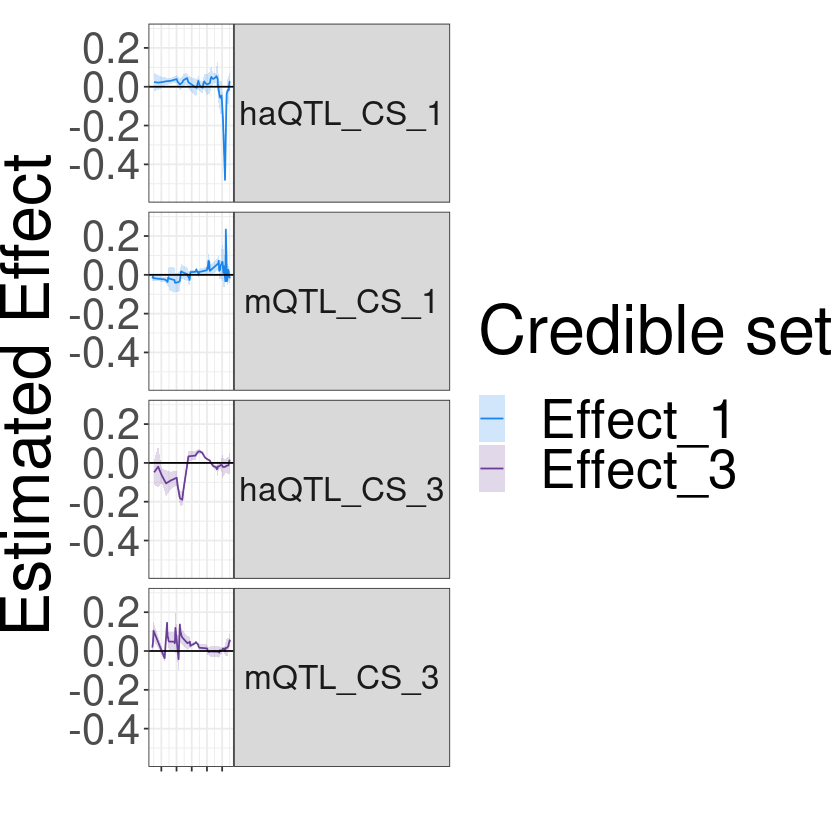

In [51]:
refine_effect_plot

In [52]:
options(repr.plot.width =30, repr.plot.height = 40)

In [53]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(6,1,6))


ERROR: Error in cowplot::plot_grid(plotlist = list(refine_effect_plot + xlim(plot_range), : object 'gene_plot' not found


In [151]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(6,1,6))%>%ggsave(filename = "CaseStudy_tad435.pdf",device = "pdf", width = 30, height = 30,dpi = "retina")

In [51]:
refine_effect_plot


ERROR: Error in eval(expr, envir, enclos): object 'refine_effect_plot' not found


In [196]:
rbind(output_me,output_ha)%>%group_by(effect)%>%filter(effect != "Effect_6")%>%write_delim("4_808_effect.tsv","\t")

In [191]:
color2 = c("black", "green4", "#FF7F00","skyblue2","#6A3D9A",
       "gold1",  "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
refine_effect_plot =  rbind(output_me,output_ha)%>%group_by(effect)%>%filter(effect != "Effect_6")%>%ggplot(linewidth = 7)+
     geom_line(aes(x = pos, y = mid,color = effect))+geom_ribbon(aes(x = pos, y = mid,ymin = low, ymax = up,fill = effect), alpha = 0.2)+
         ylab("Estimated Effect") + xlab("POS")+facet_grid(factor(type,levels =  c("haQTL_Effect_1","mQTL_Effect_1","haQTL_Effect_2","mQTL_Effect_2","haQTL_Effect_4","mQTL_Effect_4"), label =  c("haQTL_CS_1","mQTL_CS_1","haQTL_CS_2","mQTL_CS_2","haQTL_CS_4","mQTL_CS_4"))~. )+
         scale_color_manual("Credible set",values = color2[n+1])+geom_hline(aes(yintercept = 0), color = "black")+
         scale_fill_manual("Credible set",values = color2[n+1])+theme_bw()+
         xlab("") + 
         ylab("Estimated Effect")+ 
         theme(text = element_text(size = 40))+  theme(plot.margin=unit(c(5,0,0,0),"mm"), strip.text.y.right = element_text(angle = 0,size = 20),axis.text.x = element_blank(),axis.text.y = element_text(size = 25))

In [ ]:
plot_range

In [ ]:

%>%ggsave(filename = "CaseStudy_tad808.pdf",device = "pdf", width = 30, height = 30,dpi = "retina")

In [ ]:
options(repr.plot.width =30, repr.plot.height = 30)

In [ ]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(3,1,6))%>%ggsave(filename = "CaseStudy_tad808.pdf",device = "pdf", width = 30, height = 30,dpi = "retina")


In [ ]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(3,1,6))

## Archived: Tad 435

In [66]:
plot_435 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/text_book/haQTL_mQTL_eQTL.tad435.pip_landscape_plot.rds")

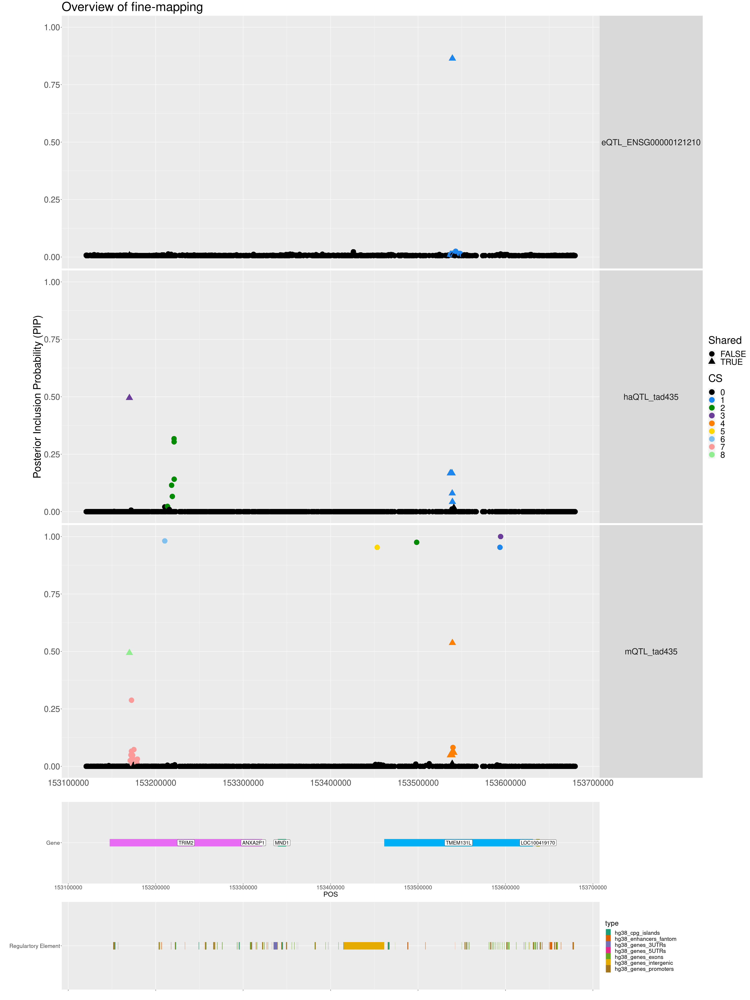

In [68]:
cowplot::plot_grid(plotlist = list(plot_435[[1]],plot_435[[4]],plot_435[[3]]) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(8,1,1))


In [69]:
cowplot::plot_grid(plotlist = list(refine_effect_plot+ xlim(plot_range),
                                    gene_plot+theme_bw()+theme(axis.text.x = element_blank(),axis.text.y = element_blank()) + theme(strip.text.y.right = element_text(angle = 0))+ xlab("") +theme(text = element_text(size = 40)),
                                   refine_plot+theme_bw()+theme(axis.ticks.x = element_blank()) + theme(strip.text.y.right = element_text(angle = 0,size = 20))+ xlab("") +theme(text = element_text(size = 40),panel.spacing=unit(2, "lines"))
                                  ) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(3,1,6))


ERROR: Error in cowplot::plot_grid(plotlist = list(refine_effect_plot + xlim(plot_range), : object 'refine_effect_plot' not found


In [87]:
range435 = c(min(plot_435[[2]]%>%pull(pos)),max(plot_435[[2]]%>%pull(pos)))

In [ ]:
library("stringr")

In [70]:
range_435 = min()

Warning message in min():
“no non-missing arguments to min; returning Inf”


In [5]:
h_435 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_haQTL//haQTL.rosmap_haqtl.tad435.uni_Fsusie.mixture_normal_per_scale.rds")

In [99]:
pQTL%>%filter(variants %in% (plot_435[[2]]%>%filter(Shared)%>%count(snp, y)%>%arrange(-y)%>%pull(snp) ))

variants,snps_index,chromosome,position,ref,alt,cs_order,cs_id,log10_base_factor,pip,posterior_mean,posterior_sd,z,molecular_trait_id,finemapped_region_start,finemapped_region_end
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
chr4:153169893_G_A,172,4,153169893,G,A,0,None,-1.85750337643024;4.41449874653832;-0.272735014236476;-0.270558205631799;-0.273382533238875;-0.279283372001442;-0.285491331906462;-0.289676607320206;-0.290604024178486;-0.288080600811098,0.008372832,-0.0006084030,0.009565602,-0.06360321,4_TRIM2_Q9C040,152152162,153152162
chr4:153169959_C_T,173,4,153169959,C,T,0,None,-1.85750337643024;4.41449874653832;-0.272735014236476;-0.270558205631799;-0.273382533238875;-0.279283372001442;-0.285491331906462;-0.289676607320206;-0.290604024178486;-0.288080600811098,0.008372832,-0.0006084030,0.009565602,-0.06360321,4_TRIM2_Q9C040,152152162,153152162
chr4:153536903_C_T,1028,4,153536903,C,T,0,None,-0.711263496606845;-1.06715164295155;-0.0315576347615321;-0.0315713029807989;-0.0315366227836207;-0.0314631162517929;-0.0313719736371145;-0.0312989458180026;-0.0312737377649586;-0.0313043541811164,0.005475407,0.0001179703,0.002664210,0.04427965,4_TRIM2_Q9C040,152152162,153152162
chr4:153537319_AAG_A,1030,4,153537319,AAG,A,0,None,-0.711263496606845;-1.06715164295155;-0.0315576347615321;-0.0315713029807989;-0.0315366227836207;-0.0314631162517929;-0.0313719736371145;-0.0312989458180026;-0.0312737377649586;-0.0313043541811164,0.005475407,0.0001179703,0.002664210,0.04427965,4_TRIM2_Q9C040,152152162,153152162
chr4:153538553_C_CT,1031,4,153538553,C,CT,0,None,-0.577247341965099;-0.98182683149537;0.0110211231245441;0.0107164018207766;0.0111225318091193;0.0119691072500832;0.0128661774367678;0.013477611654513;0.0136196522528516;0.0132605178329843,0.005720003,0.0001326258,0.002799280,0.04737855,4_TRIM2_Q9C040,152152162,153152162
chr4:153538806_C_G,1033,4,153538806,C,G,0,None,-0.575311804675509;-0.977876738298285;0.0113798451415899;0.0110972354755461;0.0114750586055017;0.0122611813649369;0.0130927899177142;0.0136591686320573;0.0137916430307132;0.013461162204947,0.005721617,0.0001327230,0.002800193,0.04739781,4_TRIM2_Q9C040,152152162,153152162
chr4:153538959_C_T,1035,4,153538959,C,T,0,None,-0.575311804675509;-0.977876738298285;0.0113798451415899;0.0110972354755461;0.0114750586055017;0.0122611813649369;0.0130927899177142;0.0136591686320573;0.0137916430307132;0.013461162204947,0.005721617,0.0001327230,0.002800193,0.04739781,4_TRIM2_Q9C040,152152162,153152162
chr4:153539093_G_A,1036,4,153539093,G,A,0,None,-0.575311804675509;-0.977876738298285;0.0113798451415899;0.0110972354755461;0.0114750586055017;0.0122611813649369;0.0130927899177142;0.0136591686320573;0.0137916430307132;0.013461162204947,0.005721617,0.0001327230,0.002800193,0.04739781,4_TRIM2_Q9C040,152152162,153152162
chr4:153539263_G_A,1037,4,153539263,G,A,0,None,-0.478741017910657;-0.959626218265559;-0.0297650257485462;-0.0298159445961363;-0.0297437153678703;-0.0295854915612559;-0.0294030811469439;-0.0292685020583558;-0.0292318608002371;-0.0293044574853751,0.005487746,0.0001187595,0.002672315,0.04444066,4_TRIM2_Q9C040,152152162,153152162


In [102]:
eQTL%>%filter(variants %in% (plot_435[[2]]%>%filter(Shared)%>%count(snp, y)%>%arrange(-y)%>%pull(snp) ))

variants,snps_index,chromosome,position,ref,alt,cs_order,cs_id,log10_base_factor,pip,posterior_mean,posterior_sd,z,molecular_trait_id,finemapped_region_start,finemapped_region_end
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<lgl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
chr4:153169893_G_A,172,4,153169893,G,A,c(L2 = 3),NA,-1.30152261324837;20.3604729293778;-1.12494572705448;0;0;0;0;0;0;0,0.08013588,1.908908e-11,0.056823392,3.359370e-10,ENSG00000109654,153120000,153680000
chr4:153169959_C_T,173,4,153169959,C,T,c(L2 = 3),NA,-1.30152261324837;20.3604729293778;-1.12494572705448;0;0;0;0;0;0;0,0.08013588,-1.657063e-02,0.056823392,-2.916164e-01,ENSG00000109654,153120000,153680000
chr4:153536903_C_T,1028,4,153536903,C,T,c(L1 = 1),NA,6.34572216529815;-0.124897609228727;-0.122834934690641;-0.118017510075587;-0.112976985855382;-0.109247422190065;-0.107554510081669;-0.10804607158788;-0.110444363340242;-0.114167200609949,0.01042047,1.347950e-04,0.009363858,1.439524e-02,ENSG00000121210,153120000,153680000
chr4:153537319_AAG_A,1030,4,153537319,AAG,A,c(L1 = 1),NA,6.34572216529815;-0.124897609228727;-0.122834934690641;-0.118017510075587;-0.112976985855382;-0.109247422190065;-0.107554510081669;-0.10804607158788;-0.110444363340242;-0.114167200609949,0.01042047,-6.393735e-04,0.009363858,-6.828099e-02,ENSG00000121210,153120000,153680000
chr4:153538553_C_CT,1031,4,153538553,C,CT,c(L1 = 1),NA,6.34572216529815;-0.124897609228727;-0.122834934690641;-0.118017510075587;-0.112976985855382;-0.109247422190065;-0.107554510081669;-0.10804607158788;-0.110444363340242;-0.114167200609949,0.01042047,-5.826961e-04,0.009363858,-6.222821e-02,ENSG00000121210,153120000,153680000
chr4:153538806_C_G,1033,4,153538806,C,G,c(L1 = 1),NA,6.2420671581361;-0.119390451133065;-0.117404536403362;-0.112768109131731;-0.107919626665253;-0.10433391164516;-0.10270681954871;-0.103179379982926;-0.105485013707084;-0.109065325113102,0.01000118,-4.224131e-04,0.008851437,-4.772255e-02,ENSG00000121210,153120000,153680000
chr4:153538959_C_T,1035,4,153538959,C,T,c(L1 = 1),NA,6.2420671581361;-0.119390451133065;-0.117404536403362;-0.112768109131731;-0.107919626665253;-0.10433391164516;-0.10270681954871;-0.103179379982926;-0.105485013707084;-0.109065325113102,0.01000118,-4.848571e-04,0.008851437,-5.477721e-02,ENSG00000121210,153120000,153680000
chr4:153539093_G_A,1036,4,153539093,G,A,c(L1 = 1),NA,6.47290573102052;-0.129382151097137;-0.127255488471561;-0.122287286791159;-0.117087014048833;-0.113237967053465;-0.111490449558176;-0.111997795118791;-0.114472993918336;-0.118314195101703,0.01101497,-5.170369e-04,0.010034942,-5.152366e-02,ENSG00000121210,153120000,153680000
chr4:153539263_G_A,1037,4,153539263,G,A,c(L1 = 1),NA,11.5832545243676;-0.136716709906054;-0.134445275432789;-0.129139202127312;-0.123585641685557;-0.119476000836995;-0.117610134527188;-0.118149680328814;-0.120786702168198;-0.1248778920473,0.86421075,-6.726450e-04,0.066426122,-1.012621e-02,ENSG00000121210,153120000,153680000


In [101]:
plot_435[[2]]%>%filter(Shared)%>%count(snp)%>%select(snp)%>%write_delim("tad435_shared_snp.tsv")

In [78]:
h_435 = update_cal_credible_band2(h_435)


In [79]:
effect_extract = function(fsusie,n = 1:length(fsusie$fitted_func) ){
    color = c("black", "dodgerblue2", "green4", "#6A3D9A",
      "#FF7F00", "gold1", "skyblue2", "#FB9A99", "palegreen2",
      "#CAB2D6", "#FDBF6F", "gray70", "khaki2", "maroon", "orchid1",
      "deeppink1", "blue1", "steelblue4", "darkturquoise", "green1",
      "yellow4", "yellow3","darkorange4","brown","navyblue","#FF0000",
      "darkgreen","#FFFF00","purple","#00FF00","pink","#0000FF",
      "orange","#FF00FF","cyan","#00FFFF","#FFFFFF")
     plot_df = ((fsusie$fitted_func[n])%>%as_tibble(.name_repair = "universal")%>%mutate(pos =  fsusie$outing_grid)%>%`colnames<-`(c(paste0("Effect_",n,":mid"),"pos"))%>%mutate(`#chr` = str_split(names(fsusie$csd_X)[[1]],":")[[1]][[1]] ))%>%dplyr::select(`#chr`, pos, everything())
    plot_df = cbind(plot_df ,t(Reduce(rbind,fsusie$cred_band[n]))  )
    plot_df = plot_df%>%pivot_longer(cols = 3:ncol(plot_df), names_to = c("effect",".value"),names_prefix = "" , names_sep = ":") 
    plot=  plot_df%>%ggplot(linewidth = 7)+
     geom_line(aes(x = pos, y = mid,color = effect))+geom_ribbon(aes(x = pos, y = mid,ymin = low, ymax = up,fill = effect), alpha = 0.2)+
         ylab("Estimated Effect") + xlab("POS")+facet_grid(effect~. )+
         scale_color_manual("Credible set",values = color[n+1])+geom_hline(aes(yintercept = 0), color = "black")+
         scale_fill_manual("Credible set",values = color[n+1])+
         theme(strip.text.y.right = element_text(angle = 0))+
         xlab("") + 
         ylab("Estimated Effect")+ 
         theme(text = element_text(size = 50))+
         ggtitle(paste0( "Estimated effect"))
     return(list(plot_df,plot))
     }

In [ ]:
fsusie =  h_435

In [ ]:
n = c(1,2)

New names:
• `` -> `...1`
• `` -> `...2`


[[1]]
# A tibble: 128 × 6
   `#chr`        pos effect       mid      up      low
   <chr>       <dbl> <chr>      <dbl>   <dbl>    <dbl>
 1 chr4   153152342. Effect_1  0.0279  0.0735 -0.0178 
 2 chr4   153152342. Effect_3 -0.0204  0.0425 -0.0833 
 3 chr4   153179174. Effect_1  0.0316  0.0699 -0.00678
 4 chr4   153179174. Effect_3 -0.0520  0.0540 -0.158  
 5 chr4   153203248. Effect_1  0.0356  0.0640  0.00719
 6 chr4   153203248. Effect_3 -0.121  -0.0847 -0.156  
 7 chr4   153231369. Effect_1  0.0377  0.0567  0.0187 
 8 chr4   153231369. Effect_3 -0.142  -0.0744 -0.210  
 9 chr4   153260783. Effect_1  0.0362  0.0510  0.0214 
10 chr4   153260783. Effect_3 -0.0702 -0.0245 -0.116  
# ℹ 118 more rows

[[2]]


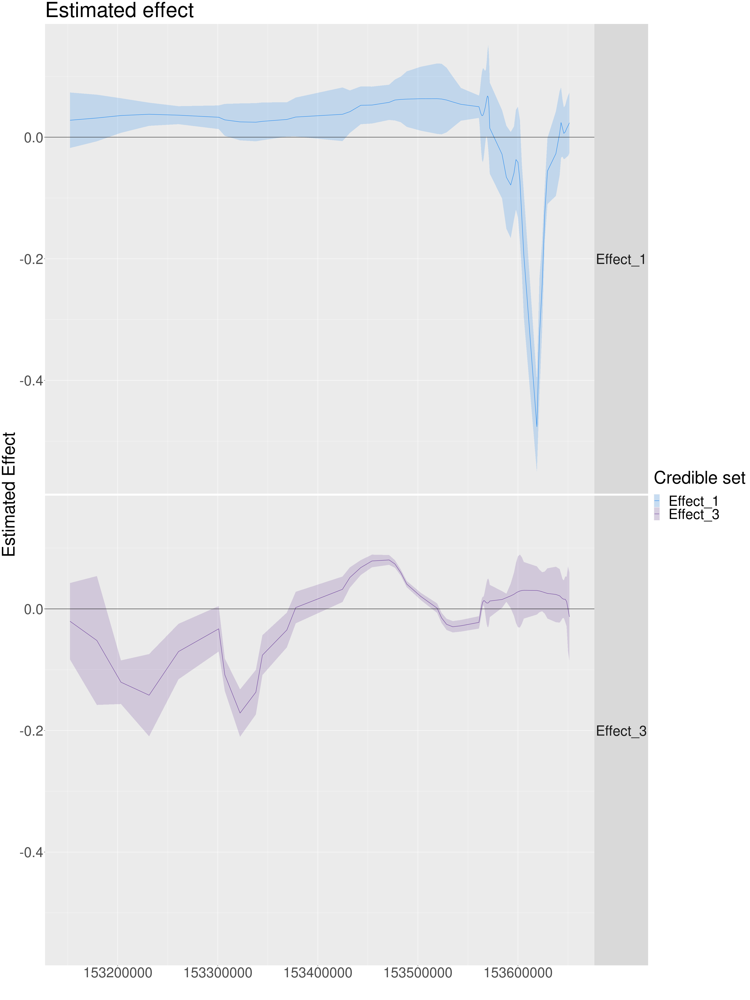

In [106]:
effect_extract(h_435,c(1,3))

In [ ]:
library("susiF.alpha")

In [ ]:
plot(plt$grobs[[2]])

In [3]:
m_435 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_mQTL/meQTL.yuqi_mqtl.tad435.uni_Fsusie.mixture_normal_per_scale.rds")

In [4]:
m_435 = update_cal_credible_band2(m_435)

ERROR: Error in update_cal_credible_band2(m_435): could not find function "update_cal_credible_band2"


In [6]:
head(m_435)

init,-1.058175e-05,1.996872e-07,3.350758e-06,-2.852824e-05,-5.378796e-06,-6.786859e-05,2.692962e-05,-3.096548e-05,3.082478e-05,-1.805546e-03,⋯,-5.104870e-05,1.301231e-03,-1.269245e-03,-1.064748e-04,-7.903582e-03,-8.257333e-06,1.474701e-03,-8.724377e-03,-0.0070192271,0
,-1.019427e-03,1.112793e-05,3.139144e-06,-3.465479e-05,-3.941096e-05,2.135480e-05,-2.788544e-07,-1.915063e-06,-6.880015e-05,6.577453e-05,⋯,-4.710478e-05,1.703046e-03,8.655096e-04,6.108649e-05,1.430347e-03,-3.701423e-05,-1.854783e-03,9.753007e-04,0.0237109561,0
,4.933252e-06,-6.636114e-07,2.587847e-06,-1.003333e-05,-1.297034e-05,9.081308e-06,2.152882e-05,4.564621e-07,-1.097751e-04,2.925797e-05,⋯,5.358323e-05,-3.199658e-03,6.577760e-04,2.742869e-04,1.076813e-02,1.069492e-04,1.627838e-04,1.195950e-02,0.0367882471,0
,-8.961911e-06,1.457726e-07,3.711688e-06,-3.194584e-05,-1.912679e-06,-8.236473e-05,2.316649e-05,-2.789148e-05,3.294072e-05,-2.565636e-03,⋯,-5.334503e-05,1.311696e-03,-1.888700e-03,-1.335471e-04,-3.710041e-03,-4.062465e-05,1.556218e-03,-6.781835e-03,-0.0084647875,0
,2.419839e-05,-2.041508e-08,-5.440833e-05,1.458486e-04,1.883799e-04,-5.373798e-05,2.809824e-06,-3.255721e-05,6.371118e-06,1.157103e-06,⋯,-2.159895e-04,-3.351490e-04,5.322494e-05,-4.050483e-04,-5.758418e-05,-5.415344e-04,-1.425251e-02,1.425796e-03,-0.0006456395,0
,-4.294567e-04,1.901200e-06,2.044604e-05,-4.410584e-04,6.147121e-06,-1.602051e-04,-3.398788e-05,2.241080e-06,1.262212e-06,7.461278e-06,⋯,-2.600132e-05,4.845112e-03,-3.249413e-05,-1.042685e-04,-2.299051e-04,-2.871484e-04,-2.447151e-04,2.675215e-04,0.0010625519,0
,3.537862e-06,-3.653866e-07,1.726120e-06,-1.399841e-05,4.095482e-05,-7.714670e-05,-5.621145e-04,4.154845e-05,5.306060e-06,3.156371e-03,⋯,2.718738e-04,-4.379141e-05,7.457144e-06,-1.638531e-04,2.853977e-05,-2.233082e-04,-2.487806e-03,3.553765e-03,0.0012347187,0
,1.824744e-04,-2.183500e-04,3.145291e-05,-3.610103e-05,-8.362883e-05,1.109175e-05,4.324544e-05,-6.386840e-05,4.141052e-06,-1.008887e-04,⋯,5.275964e-04,-2.463740e-02,3.559093e-05,-4.238959e-06,3.714304e-04,5.745513e-04,1.439363e-03,-2.882437e-04,0.0007200022,0
,4.920163e-06,-4.760245e-07,1.766120e-06,-1.450503e-05,4.772142e-05,-9.669722e-05,-4.122757e-04,3.625918e-05,5.359813e-06,3.094997e-03,⋯,2.922033e-04,-7.449323e-05,-2.130768e-06,-1.908140e-04,4.149502e-05,-2.077576e-04,-2.139472e-03,3.752265e-03,0.0013861389,0
,-8.961911e-06,1.457726e-07,3.711688e-06,-3.194584e-05,-1.912679e-06,-8.236473e-05,2.316649e-05,-2.789148e-05,3.294072e-05,-2.565636e-03,⋯,-5.334503e-05,1.311696e-03,-1.888700e-03,-1.335471e-04,-3.710041e-03,-4.062465e-05,1.556218e-03,-6.781835e-03,-0.0084647875,0
,9.293339e-06,-5.062116e-07,5.696046e-08,2.424779e-06,-8.362342e-07,6.167236e-06,3.483569e-05,3.240886e-05,-1.231349e-05,2.032684e-05,⋯,-2.007197e-04,-1.416514e-04,2.438979e-04,7.013153e-05,-4.408283e-05,3.747645e-05,4.223460e-03,-7.619701e-04,0.0003714655,0


## output for refine analysis

In [11]:
h435_input = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/rerun/cache/fsusie.rosmap_haqtl.tad435.uni_Fsusie.mixture_normal_per_scale.rds")

In [12]:
h435_input

In [15]:
m435_input = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/rerun/cache/fsusie.yuqi_mqtl.tad435.uni_Fsusie.mixture_normal_per_scale.rds")

In [16]:
m_435$input_data = m435_input$input_data

In [21]:
m_435$input_data$pos

[1] 153127095 153128048 153128060 153137231 153151136 153152219 153152328
  [8] 153152349 153152464 153152557 153152661 153152763 153152869 153152969
 [15] 153152972 153152975 153152993 153153003 153153107 153153235 153153585
 [22] 153153892 153154319 153155668 153156457 153171115 153191397 153204056
 [29] 153204222 153204301 153204383 153204442 153204485 153204529 153204568
 [36] 153205329 153216643 153221560 153222542 153222796 153223134 153223310
 [43] 153223648 153226689 153234136 153241838 153246035 153248347 153248662
 [50] 153249258 153249386 153249438 153249532 153249631 153249670 153255759
 [57] 153257125 153258249 153275618 153292684 153295383 153295485 153295613
 [64] 153295765 153295874 153296062 153297198 153299015 153307939 153309316
 [71] 153309923 153334986 153340579 153344263 153344382 153344385 153344464
 [78] 153344907 153345042 153345061 153345370 153345413 153345436 153345805
 [85] 153348266 153433202 153452327 153452361 153465388 153465537 153466008
 [92] 153466269 153466276 153466447 153466451 153466832 153467226 153467305
 [99] 153467383 153467996 153468133 153470792 153487693 153488854 153494799
[106] 153497227 153498402 153507303 153514370 153518828 153522681 153529916
[113] 153541607 153543963 153554414 153569871 153594465 153619984 153651678

In [13]:
h_435$input_data = h435_input$input_data

In [17]:
m_435%>%saveRDS("./4_435_mQTL.rds")

In [14]:
h_435%>%saveRDS("./4_435_haQTL.rds")

In [ ]:
effect_extract(m_435,c(4,8))

In [84]:
gene_name = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.region_list")
gene_body = read_delim("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/../reference_data/Homo_sapiens.GRCh38.103.chr.reformatted.collapse_only.gene.ERCC.gtf", col_names   = 0, skip = 1)

Rows: 60726 Columns: 5
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): #chr, gene_id, gene_name
dbl (2): start, end

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 481312 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (7): X1, X2, X3, X6, X7, X8, X9
dbl (2): X4, X5

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [85]:
gene_body%>%filter(X4 == gene_name%>%filter(gene_id == "ENSG00000121210")%>%pull(end)  |  X4 == gene_name%>%filter(gene_id == "ENSG00000121210")%>%pull(end) +1 ) 

X1,X2,X3,X4,X5,X6,X7,X8,X9
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
chr4,ensembl_havana,gene,153466346,153636711,.,+,.,"gene_id ""ENSG00000121210""; transcript_id ""ENSG00000121210""; gene_type ""protein_coding""; gene_name ""TMEM131L""; transcript_type ""protein_coding""; transcript_name ""TMEM131L""; gene_version ""16""; gene_source ""ensembl_havana"";"
chr4,ensembl_havana,transcript,153466346,153636711,.,+,.,"gene_id ""ENSG00000121210""; transcript_id ""ENSG00000121210""; gene_type ""protein_coding""; gene_name ""TMEM131L""; transcript_type ""protein_coding""; transcript_name ""TMEM131L""; gene_version ""16""; gene_source ""ensembl_havana"";"
chr4,ensembl_havana,exon,153466346,153466521,.,+,.,"gene_id ""ENSG00000121210""; transcript_id ""ENSG00000121210""; gene_type ""protein_coding""; gene_name ""TMEM131L""; transcript_type ""protein_coding""; transcript_name ""TMEM131L""; gene_version ""16""; gene_source ""ensembl_havana""; exon_id ""ENSG00000121210_1; exon_number 1"";"


New names:
• `` -> `...1`
• `` -> `...2`
New names:
• `` -> `...1`
• `` -> `...2`
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.


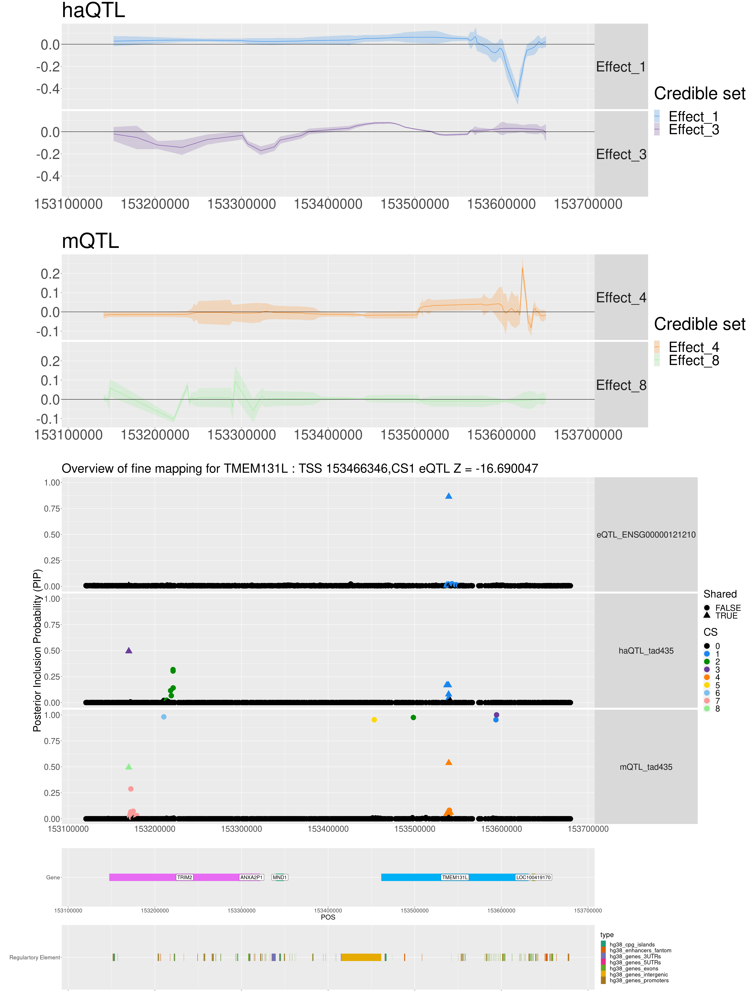

In [108]:
cowplot::plot_grid(plotlist = list(effect_extract(h_435,c(1,3))[[2]]+xlim(range435)+
         ggtitle(paste0( "haQTL"))+ylab(""),effect_extract(m_435,c(4,8))[[2]]+xlim(range435)+
         ggtitle(paste0( "mQTL"))+ylab(""),plot_435[[1]]+ggtitle(paste0( "Overview of fine mapping for TMEM131L : TSS 153466346,CS1 eQTL Z = -16.690047"))+xlim(range435),plot_435[[4]],plot_435[[3]]) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(3,3,5,1,1))


## Archived: Tad 808

In [ ]:
plot_808 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/text_book/haQTL_mQTL_eQTL.tad808.pip_landscape_plot.rds")

In [ ]:
cowplot::plot_grid(plotlist = list(plot_808[[1]],plot_808[[4]],plot_808[[3]]) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(8,1,1))


In [ ]:
library("stringr")

In [ ]:
h_808 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_haQTL//haQTL.rosmap_haqtl.tad808.uni_Fsusie.mixture_normal_per_scale.rds")

In [ ]:
h_808 = update_cal_credible_band2(h_808)

In [ ]:
m_808 = readRDS("/mnt/vast/hpc/csg/molecular_phenotype_calling/QTL_fine_mapping/output/definitive_mQTL/meQTL.yuqi_mqtl.tad808.uni_Fsusie.mixture_normal_per_scale.rds")

In [ ]:
m_808 = update_cal_credible_band2(m_808)

In [ ]:
effect_extract(m_808,c(18))

In [88]:
cowplot::plot_grid(plotlist = list(effect_extract(h_808,2)[[2]]+geom_vline(aes(xintercept = 142670308),color = "black")+xlim(c(141500000,143000000))+
         ggtitle(paste0( "haQTL"))+ylab(""),effect_extract(m_808,c(18))[[2]]+geom_vline(aes(xintercept = 142670308),color = "black")+xlim(c(141500000,143000000))+
         ggtitle(paste0( "mQTL"))+ylab(""),plot_808[[1]]+
         ggtitle(paste0( "Overview of fine mapping for PSCA: TSS 142670308,CS2 eQTL Z = 7.781176 "))+xlim(c(141500000,143000000)),plot_808[[4]],plot_808[[3]]) ,ncol = 1, align = "v",axis = "tlbr",rel_heights = c(3,3,5,1,1))


ERROR: Error in as_tibble(., .name_repair = "universal"): object 'h_808' not found
